In [ ]:
from google.colab import drive
drive.mount('/content/drive')

%cd /content/drive/MyDrive/Python/dacon/raw

Mounted at /content/drive
/content/drive/MyDrive/Python/dacon/raw


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from matplotlib import cm
import seaborn as sns
import bisect
from tqdm import tqdm
from sklearn.metrics import mean_absolute_error
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import KFold

train_df = pd.read_csv('train.csv')
test_df = pd.read_csv('test.csv')

In [ ]:
# autogluon 학습을 위한 데이터 형태로 변환
train = train_df.drop(['SAMPLE_ID'], axis=1)
test = test_df.drop(['SAMPLE_ID'], axis=1)

In [ ]:
# 결측치가 있는 행 (1개) 제거
train = train.dropna(subset=['BREADTH'])

<Axes: ylabel='IS_CI'>

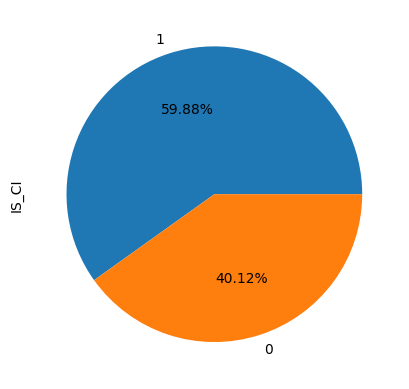

In [ ]:
# IS_CI 컬럼 추가
train['IS_CI'] = (train['CI_HOUR'] != 0).astype(int)
train['IS_CI'].value_counts().plot.pie(autopct = '%.2f%%')

In [ ]:
# CI_HOUR가 0 이상인 그룹의 특징만을 탐색
train = train[train['IS_CI']!=0]

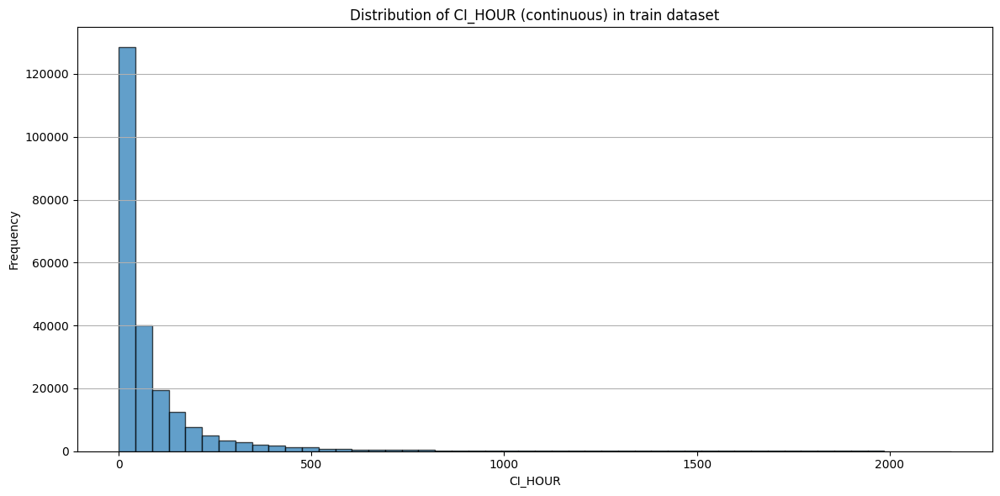

In [ ]:
# 연속형 변수로 임의의 데이터 생성
# 시각화
plt.figure(figsize=(12,6))
plt.hist(train['CI_HOUR'], bins=50, edgecolor='black', alpha=0.7)
plt.xlabel('CI_HOUR')
plt.ylabel('Frequency')
plt.title('Distribution of CI_HOUR (continuous) in train dataset')
plt.grid(axis='y')

plt.tight_layout()
plt.show()

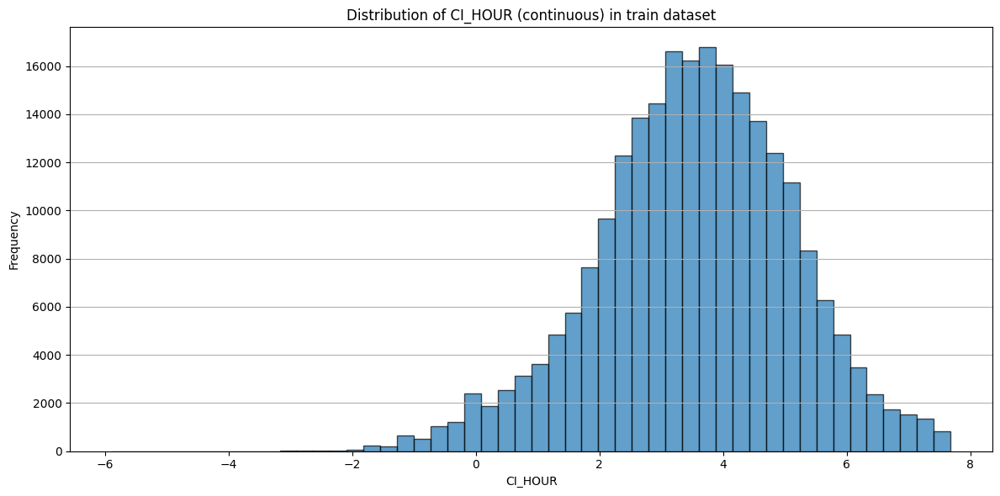

In [ ]:
# 연속형 변수로 임의의 데이터 생성
# 시각화
plt.figure(figsize=(12,6))
plt.hist(train['CI_HOUR'].map(lambda x: np.log(x+ 1e-9)), bins=50, edgecolor='black', alpha=0.7)
plt.xlabel('CI_HOUR')
plt.ylabel('Frequency')
plt.title('Distribution of CI_HOUR (continuous) in train dataset')
plt.grid(axis='y')

plt.tight_layout()
plt.show()

In [ ]:
train['CI_HOUR'].map(lambda x: np.log(x+ 1e-9)).mean()

7.307654926563866

<ipython-input-21-1bc85e288685>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train['ATA'] = pd.to_datetime(train['ATA'])
<ipython-input-21-1bc85e288685>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train['Year-Month'] = train['ATA'].dt.to_period('M')
<ipython-input-21-1bc85e288685>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

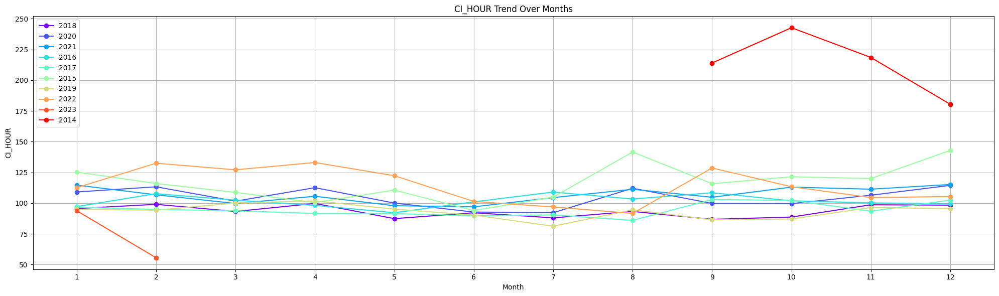

In [ ]:
# 가정: train 변수에 데이터가 이미 로드되어 있음
train['ATA'] = pd.to_datetime(train['ATA'])

# 월 정보를 추가
train['Year-Month'] = train['ATA'].dt.to_period('M')
train['Year'] = train['ATA'].dt.year  # 연도 정보를 추가

# 연도별로 그룹화
years = train['Year'].unique()

# 그래프 생성
plt.figure(figsize=(20,6))

# 각 연도에 대해 그래프 그리기
colors = cm.rainbow(np.linspace(0, 1, len(years)))  # 다양한 색상 생성
for i, year in enumerate(years):
    yearly_data = train[train['Year'] == year]
    average_ci_hour_per_month = yearly_data.groupby('Year-Month')['CI_HOUR'].mean().reset_index()
    plt.plot(average_ci_hour_per_month['Year-Month'].dt.month,  # 월 정보만 사용
             average_ci_hour_per_month['CI_HOUR'],
             marker='o',
             linestyle='-',
             color=colors[i],  # 색상 지정
             label=f'{year}')  # 범례에 연도 표시

# 그래프 설정
plt.title('CI_HOUR Trend Over Months')
plt.xlabel('Month')
plt.ylabel('CI_HOUR')
plt.grid(True)
plt.xticks(range(1, 13))  # x축을 월 정보로 설정
plt.legend()  # 범례 표시
plt.tight_layout()
plt.show()


In [ ]:
for i in train.columns:
  print(i+ ": "+ str(len(train[i].unique())) +"/"+ str(train[i].dtypes))

ARI_CO: 25/object
ARI_PO: 103/object
SHIP_TYPE_CATEGORY: 4/object
DIST: 234266/float64
ATA: 336608/object
ID: 25027/object
BREADTH: 6/float64
BUILT: 64/int64
DEADWEIGHT: 1963/int64
DEPTH: 4/float64
DRAUGHT: 3/float64
GT: 1783/int64
LENGTH: 37/float64
SHIPMANAGER: 6565/object
FLAG: 125/object
U_WIND: 2634/float64
V_WIND: 2958/float64
AIR_TEMPERATURE: 706/float64
BN: 80333/float64
ATA_LT: 24/int64
PORT_SIZE: 101/float64
CI_HOUR: 178584/float64


In [ ]:
# datetime 컬럼 처리
train['ATA'] = pd.to_datetime(train['ATA'])
test['ATA'] = pd.to_datetime(test['ATA'])

#datetime을 여러 파생 변수로 변환
for df in [train, test]:
    df['year'] = df['ATA'].dt.year
    df['month'] = df['ATA'].dt.month
    df['day'] = df['ATA'].dt.day
    df['hour'] = df['ATA'].dt.hour
    df['minute'] = df['ATA'].dt.minute
    df['weekday'] = df['ATA'].dt.weekday

<ipython-input-22-d949d4b77ddf>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train['ATA'] = pd.to_datetime(train['ATA'])
<ipython-input-22-d949d4b77ddf>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['year'] = df['ATA'].dt.year
<ipython-input-22-d949d4b77ddf>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gui

In [ ]:
# 국가와 월 정보를 활용하여 보간 시도
# missing_rows = train[train.isnull().any(axis=1)]
# missing_rows

# group = train.groupby(by = ['ARI_CO', 'month']).mean().loc[:,['U_WIND','V_WIND','AIR_TEMPERATURE','BN']]

# missing_rows['U_WIND'] = missing_rows.apply(lambda x: group.loc[x['ARI_CO'],x['month']]['U_WIND'], axis=1)
# missing_rows['V_WIND'] = missing_rows.apply(lambda x: group.loc[x['ARI_CO'],x['month']]['V_WIND'], axis=1)
# missing_rows['AIR_TEMPERATURE'] = missing_rows.apply(lambda x: group.loc[x['ARI_CO'],x['month']]['AIR_TEMPERATURE'], axis=1)
# missing_rows['BN'] = missing_rows.apply(lambda x: group.loc[x['ARI_CO'],x['month']]['BN'], axis=1)

# missing_rows[missing_rows.isnull().any(axis=1)]

# missing_rows[missing_rows.isnull().any(axis=1)][missing_rows[missing_rows.isnull().any(axis=1)]['month']==4][]

#ARI_CO (도착항의 소속국가)



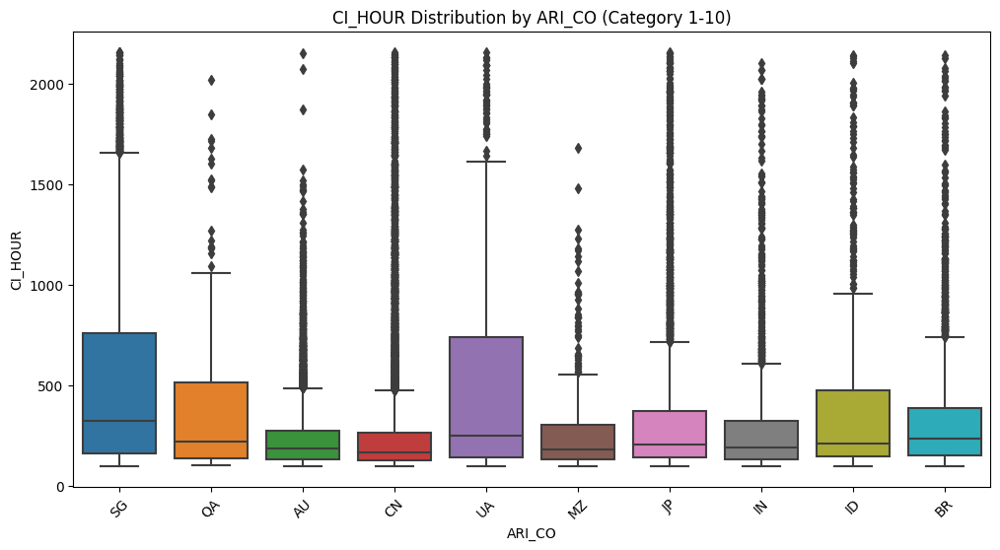

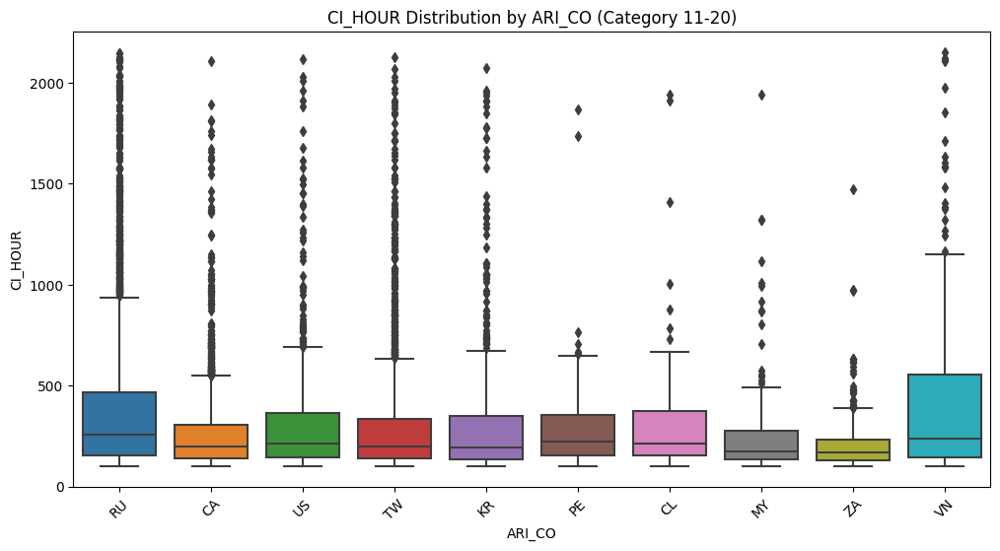

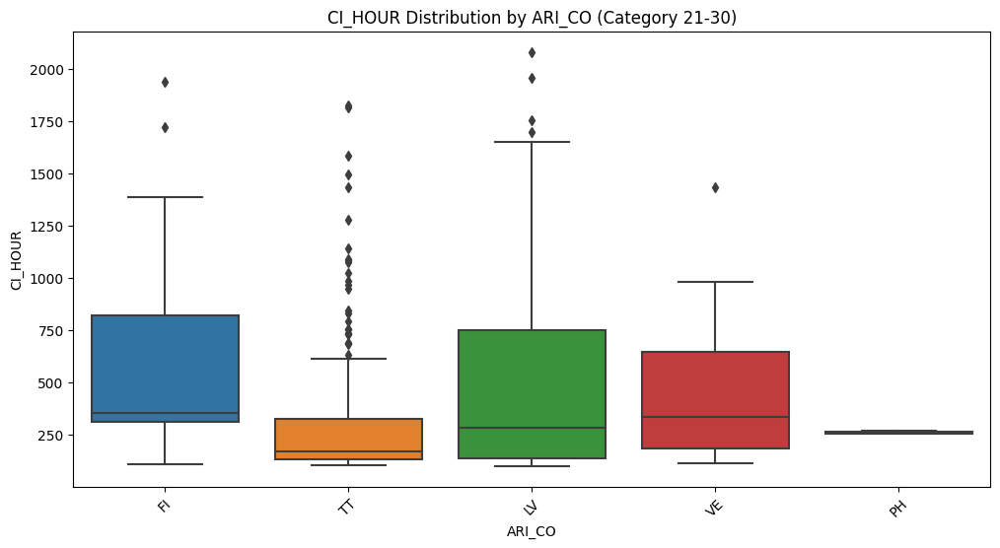

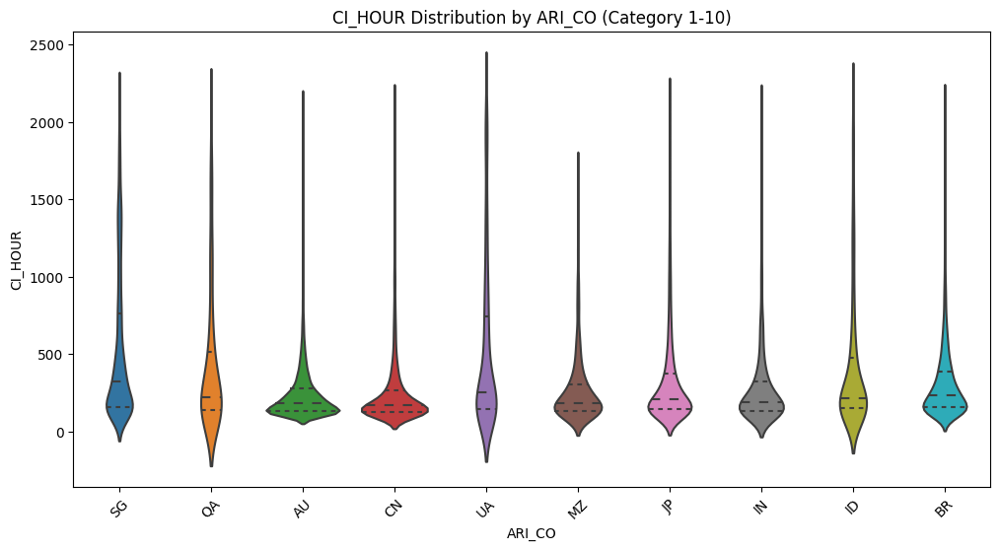

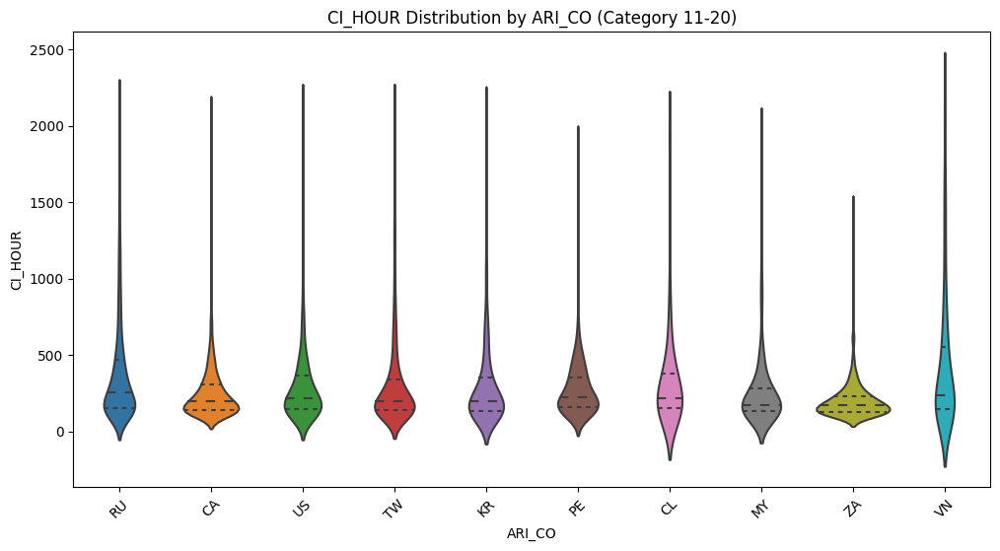

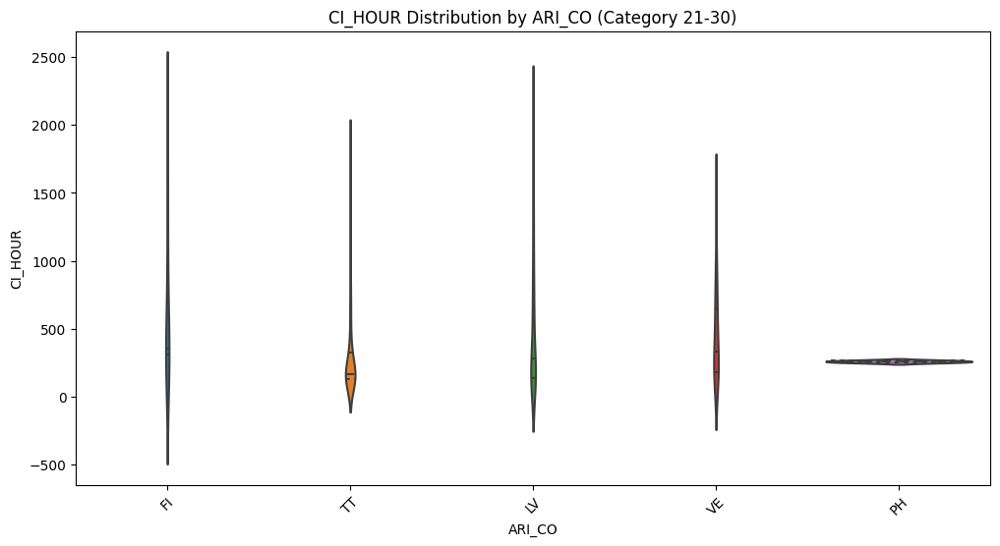

In [ ]:
target = 'ARI_CO'
# 10개씩 카테고리를 끊어서 박스 플롯 그리기
categories = train[target].unique()

for i in range(0, len(categories), 10):
    subset = train[train[target].isin(categories[i:i+10])]

    plt.figure(figsize=(12, 6))
    sns.boxplot(x=target, y='CI_HOUR', data=subset)

    plt.title(f'CI_HOUR Distribution by ARI_CO (Category {i+1}-{i+10})')
    plt.xlabel(target)
    plt.ylabel('CI_HOUR')
    plt.xticks(rotation=45)  # x축 라벨 회전 (옵션)
    plt.show()

# 10개씩 카테고리를 끊어서 바이올린 플롯 그리기
for i in range(0, len(categories), 10):
    subset = train[train[target].isin(categories[i:i+10])]

    plt.figure(figsize=(12, 6))
    sns.violinplot(x=target, y='CI_HOUR', data=subset, inner='quartile')

    plt.title(f'CI_HOUR Distribution by ARI_CO (Category {i+1}-{i+10})')
    plt.xlabel(target)
    plt.ylabel('CI_HOUR')
    plt.xticks(rotation=45)  # x축 라벨 회전 (옵션)
    plt.show()

ARI_CO
AU    236.551509
BR    318.961219
CA    257.814138
CL    335.336823
CN    268.821310
FI    610.097134
ID    416.144155
IN    302.621591
JP    338.608124
KR    321.134167
LV    497.405214
MY    265.215455
MZ    269.486603
PE    277.292011
PH    259.492222
QA    428.292133
RU    396.978745
SG    531.534441
TT    300.345450
TW    319.840969
UA    519.071160
US    311.111386
VE    451.514872
VN    456.131523
ZA    200.457009
Name: CI_HOUR, dtype: float64
ARI_CO
AU    10636
BR     4435
CA     2725
CL       80
CN    15931
FI       19
ID      717
IN     1980
JP     5167
KR      663
LV      144
MY      177
MZ      537
PE      257
PH        3
QA      159
RU     2866
SG     8016
TT      214
TW     1649
UA      624
US      755
VE       26
VN      197
ZA      532
Name: CI_HOUR, dtype: int64


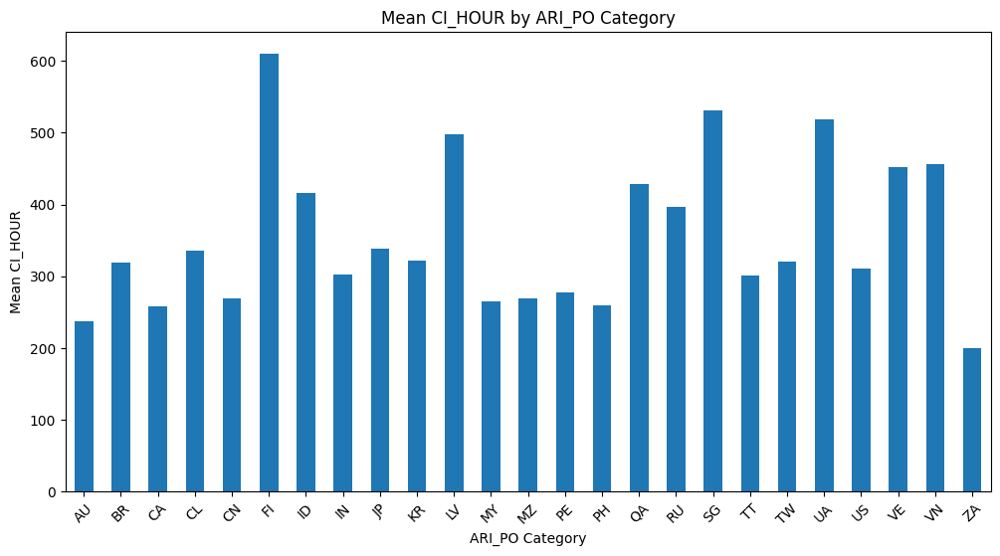

In [ ]:
# 카테고리별로 그룹화하여 CI_HOUR의 평균 계산
mean_ci_hour_per_category = train.groupby(target)['CI_HOUR'].mean()

# 결과 출력
print(mean_ci_hour_per_category)

# 카테고리별로 그룹화하여 데이터의 개수 계산
count_per_category = train.groupby(target)['CI_HOUR'].count()

# 결과 출력
print(count_per_category)

# 평균 CI_HOUR를 bar plot으로 시각화
plt.figure(figsize=(12, 6))
mean_ci_hour_per_category.plot(kind='bar')
plt.title('Mean CI_HOUR by ARI_PO Category')
plt.xlabel('ARI_CO Category')
plt.ylabel('Mean CI_HOUR')
plt.xticks(rotation=45)  # x축 라벨 회전 (옵션)
plt.show()

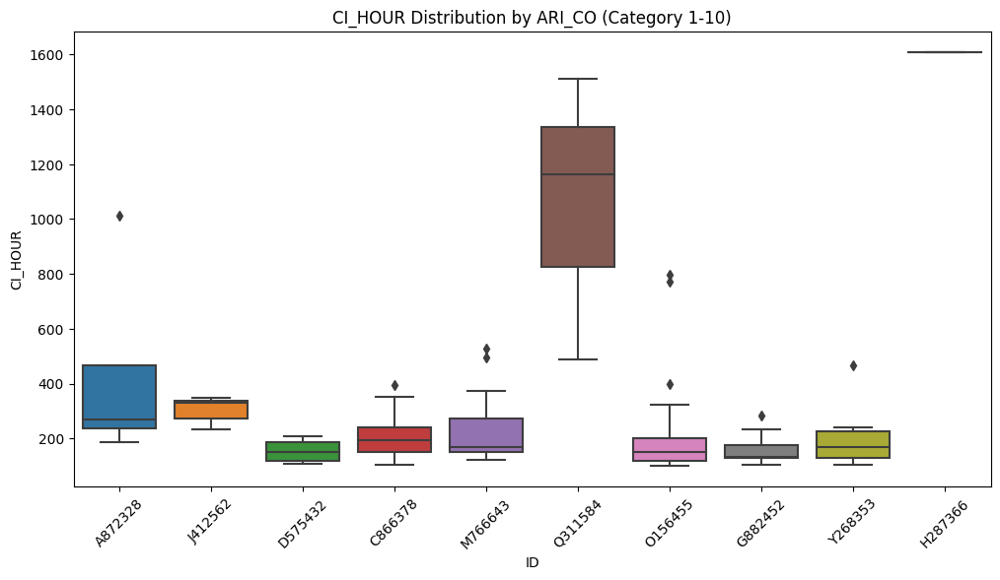

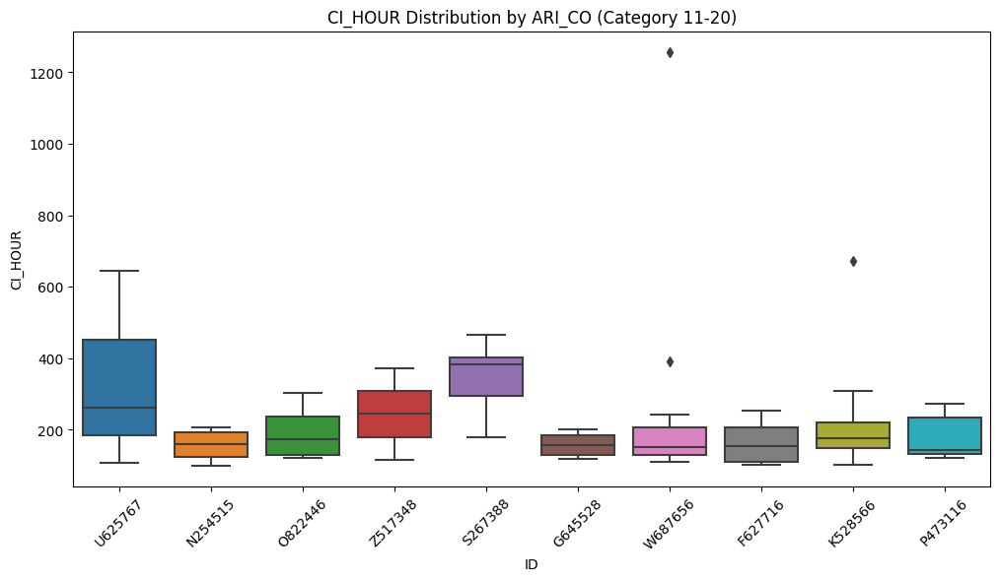

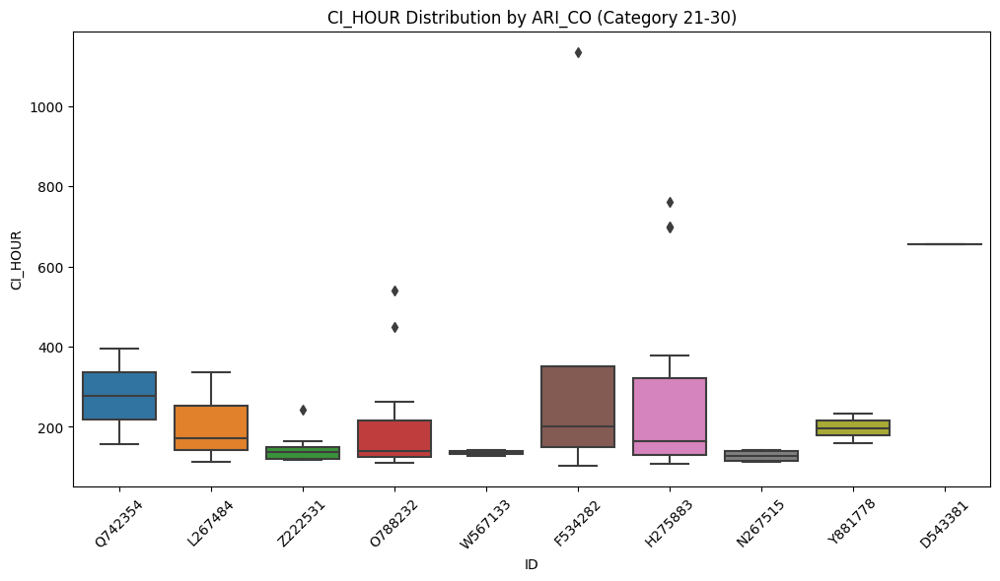

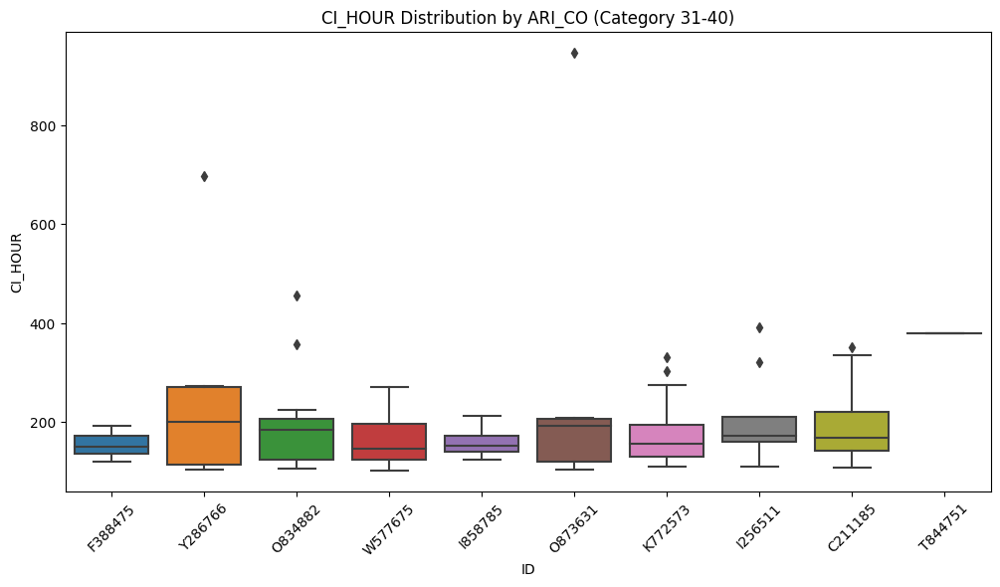

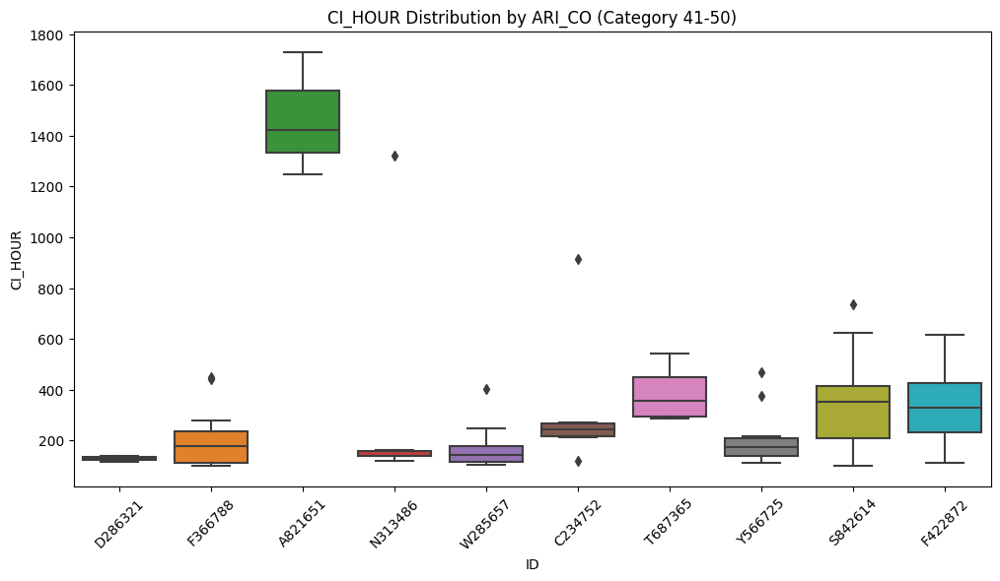

...

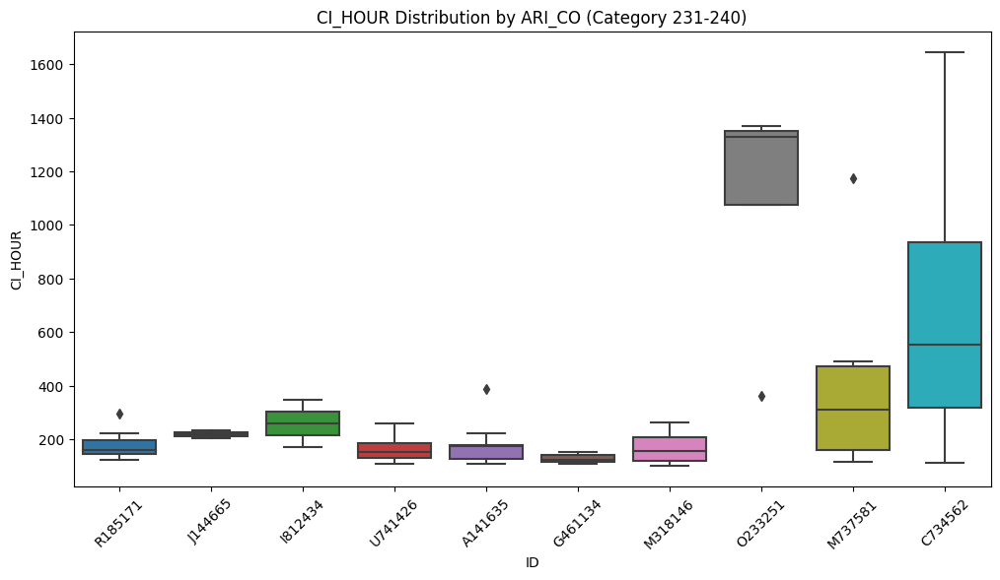

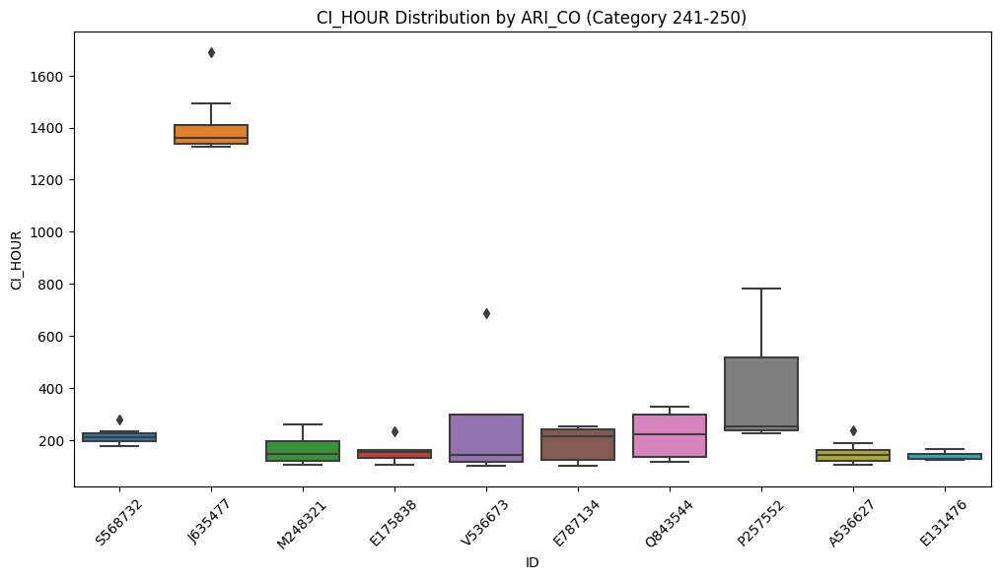

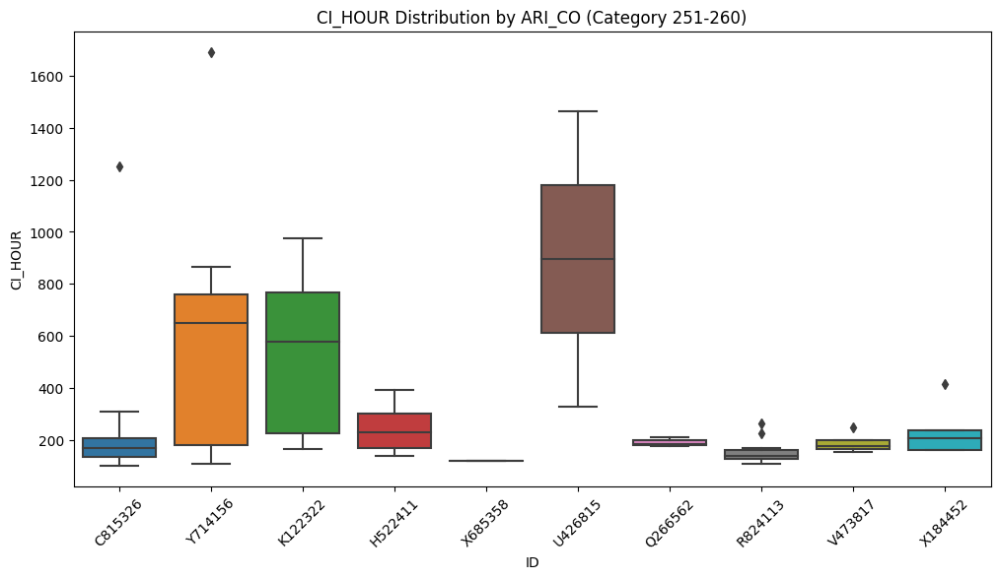

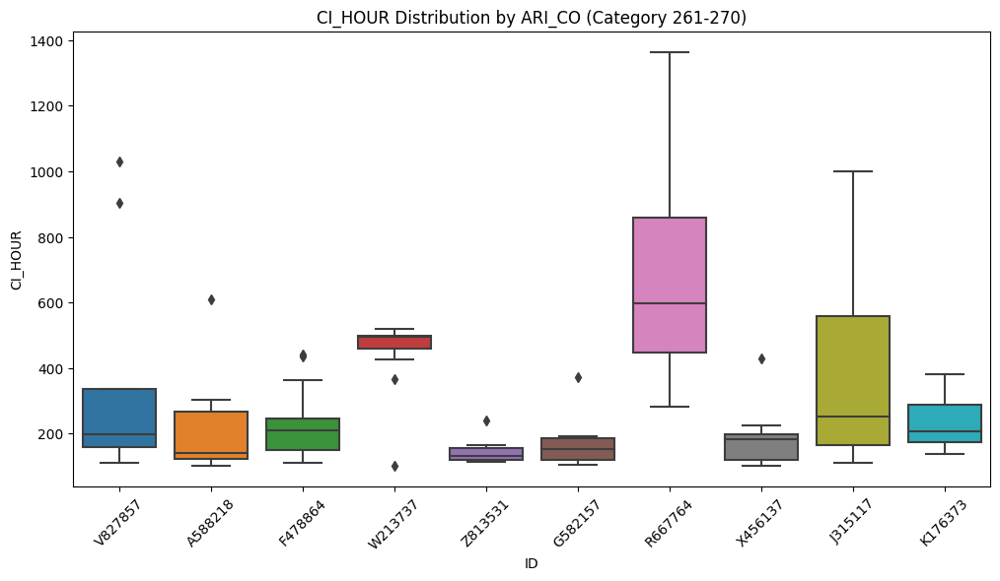

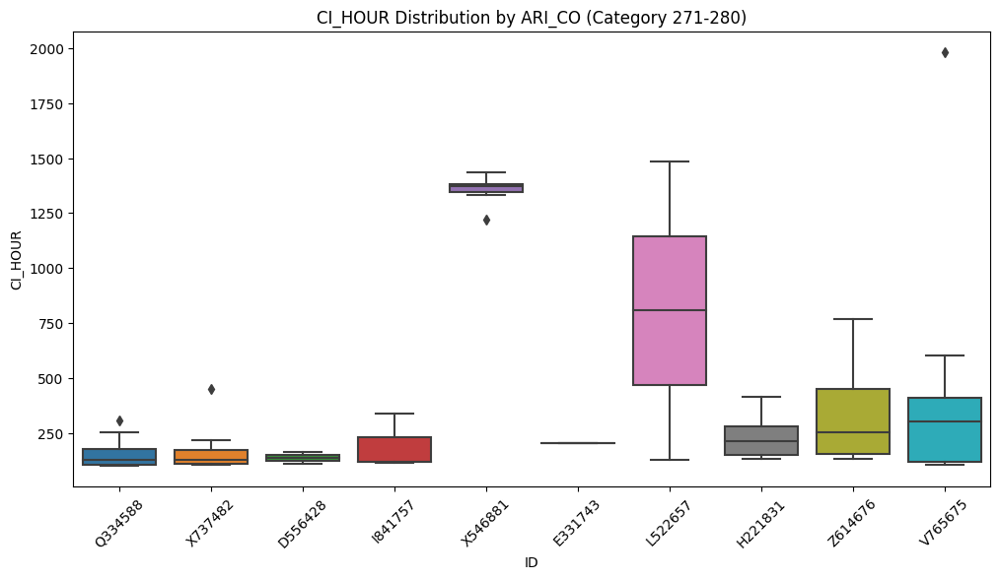

KeyboardInterrupt: ignored

In [ ]:
target = 'ID'
# 10개씩 카테고리를 끊어서 박스 플롯 그리기
categories = train[target].unique()

for i in range(0, len(categories), 10):
    subset = train[train[target].isin(categories[i:i+10])]

    plt.figure(figsize=(12, 6))
    sns.boxplot(x=target, y='CI_HOUR', data=subset)

    plt.title(f'CI_HOUR Distribution by ARI_CO (Category {i+1}-{i+10})')
    plt.xlabel(target)
    plt.ylabel('CI_HOUR')
    plt.xticks(rotation=45)  # x축 라벨 회전 (옵션)
    plt.show()

# 10개씩 카테고리를 끊어서 바이올린 플롯 그리기
for i in range(0, len(categories), 10):
    subset = train[train[target].isin(categories[i:i+10])]

    plt.figure(figsize=(12, 6))
    sns.violinplot(x=target, y='CI_HOUR', data=subset, inner='quartile')

    plt.title(f'CI_HOUR Distribution by ARI_CO (Category {i+1}-{i+10})')
    plt.xlabel(target)
    plt.ylabel('CI_HOUR')
    plt.xticks(rotation=45)  # x축 라벨 회전 (옵션)
    plt.show()

# ARI_PO (도착항의 항구명)

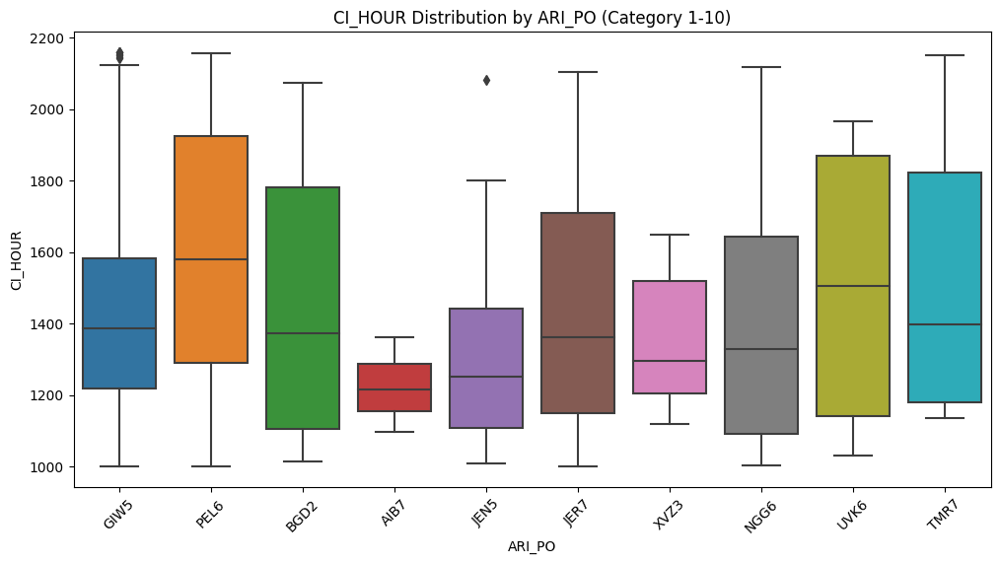

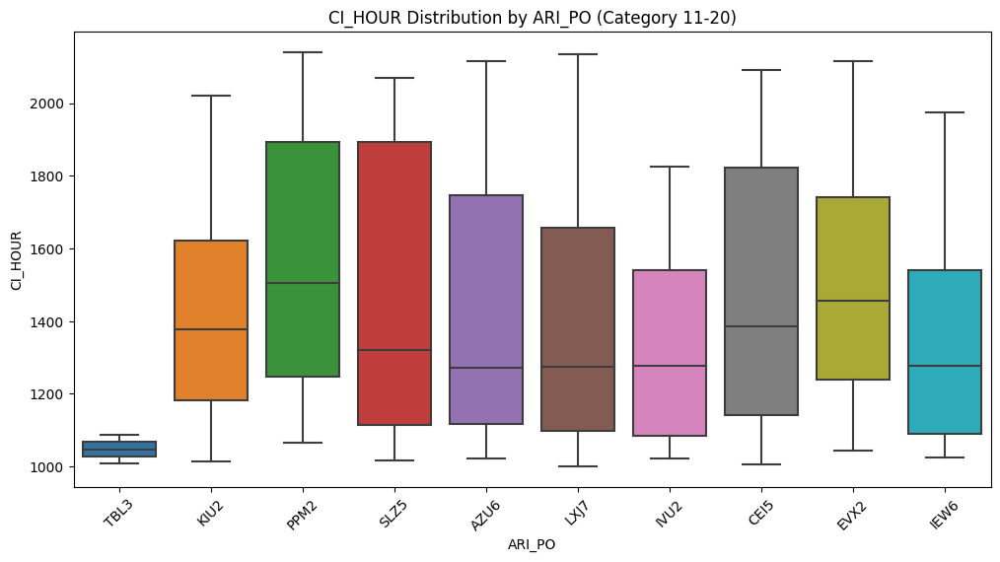

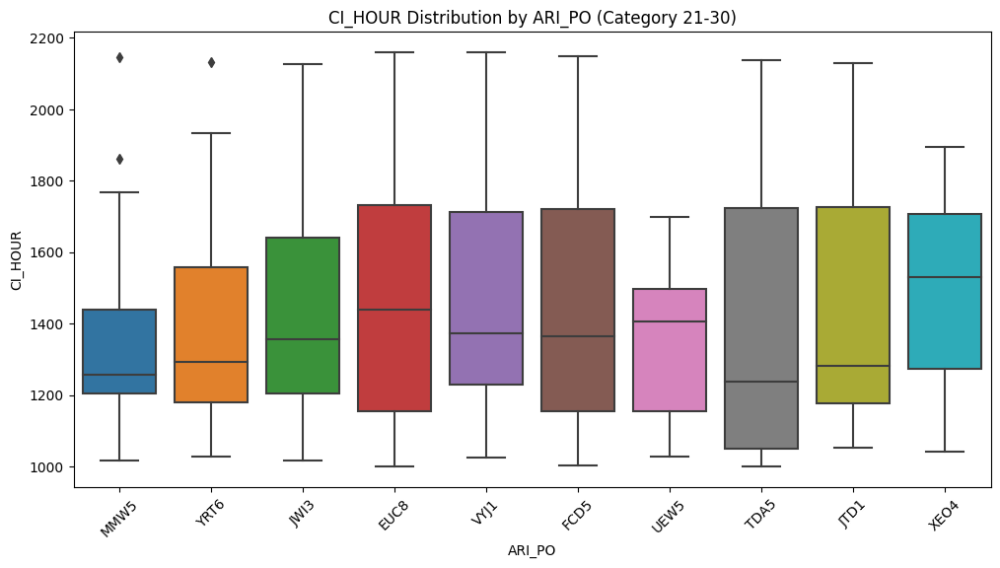

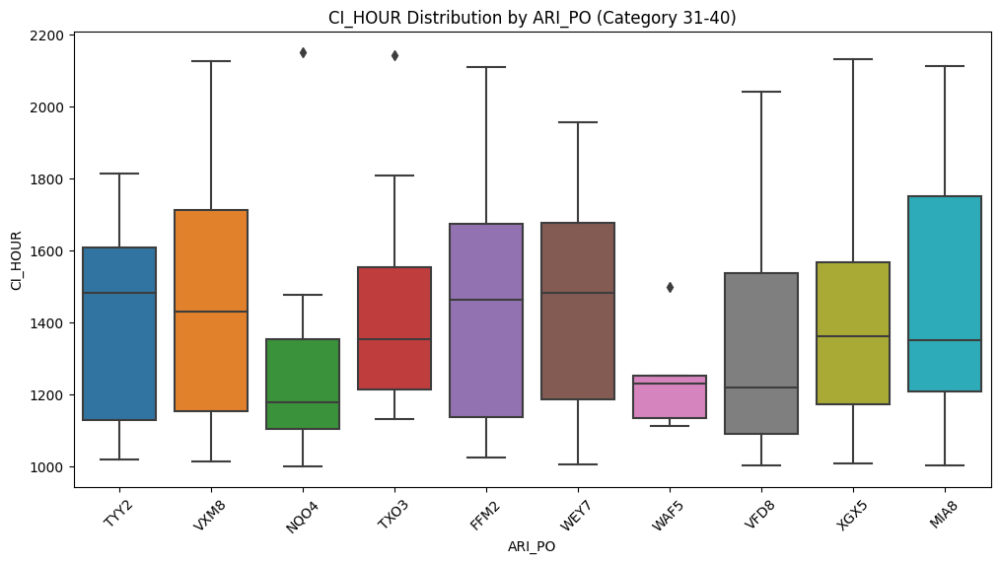

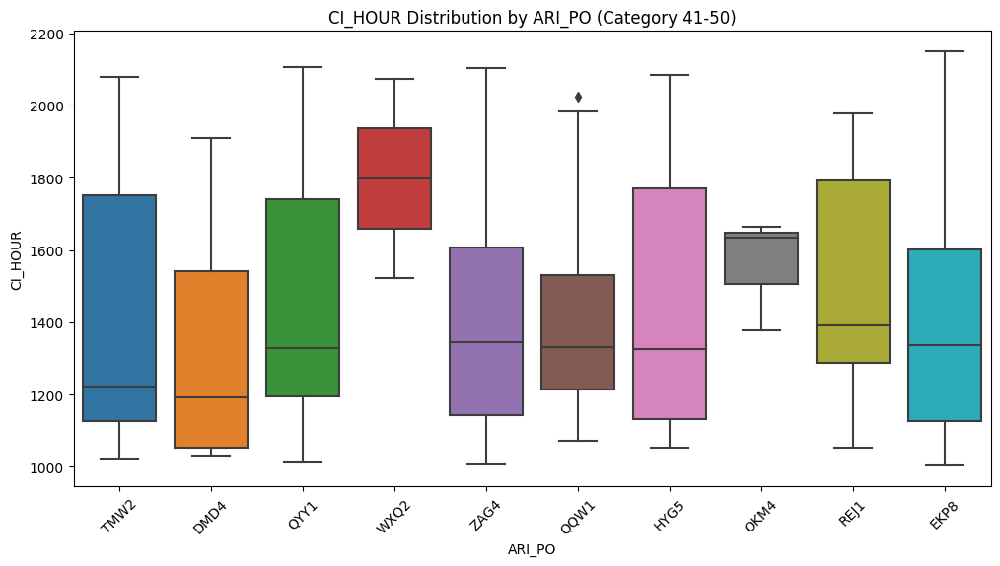

...

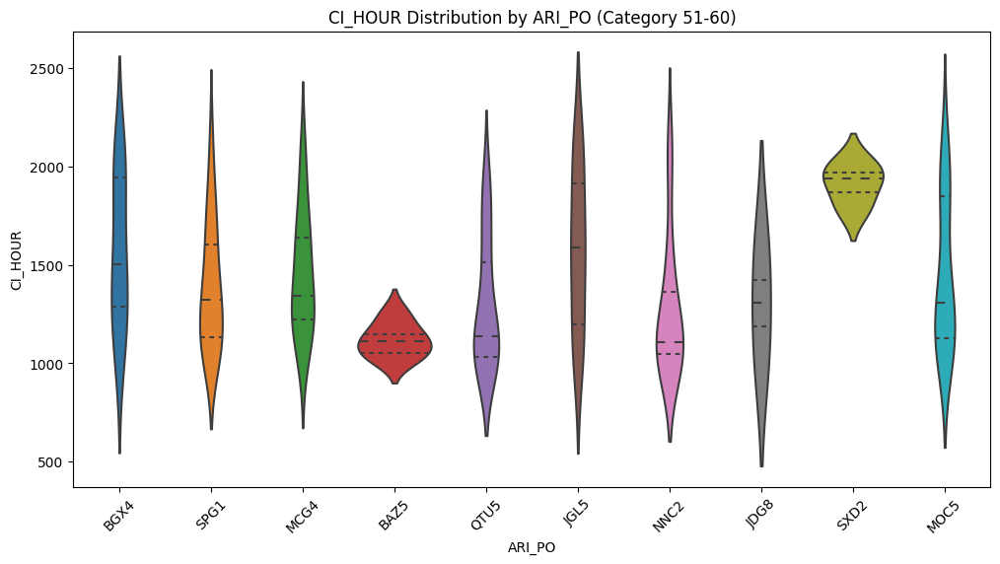

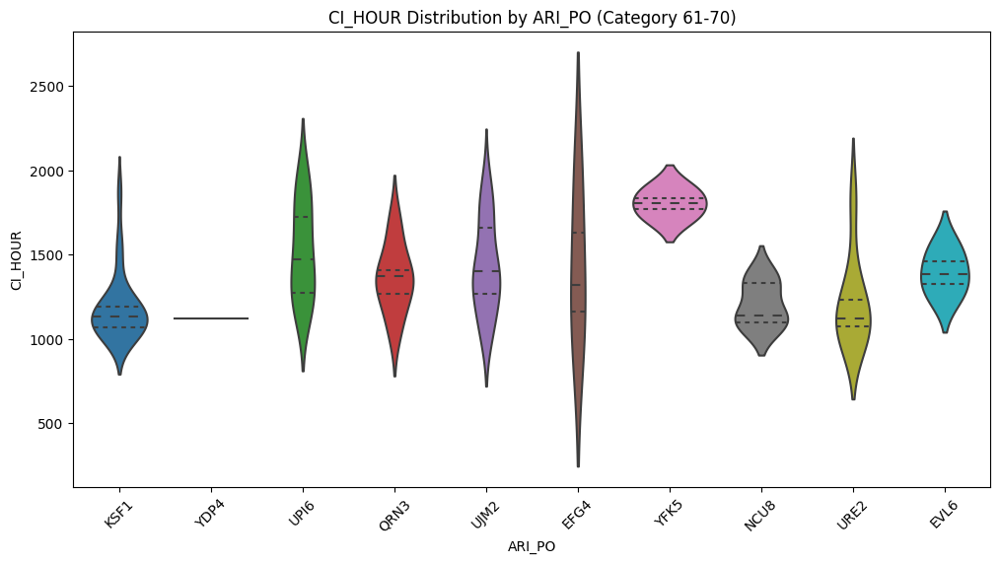

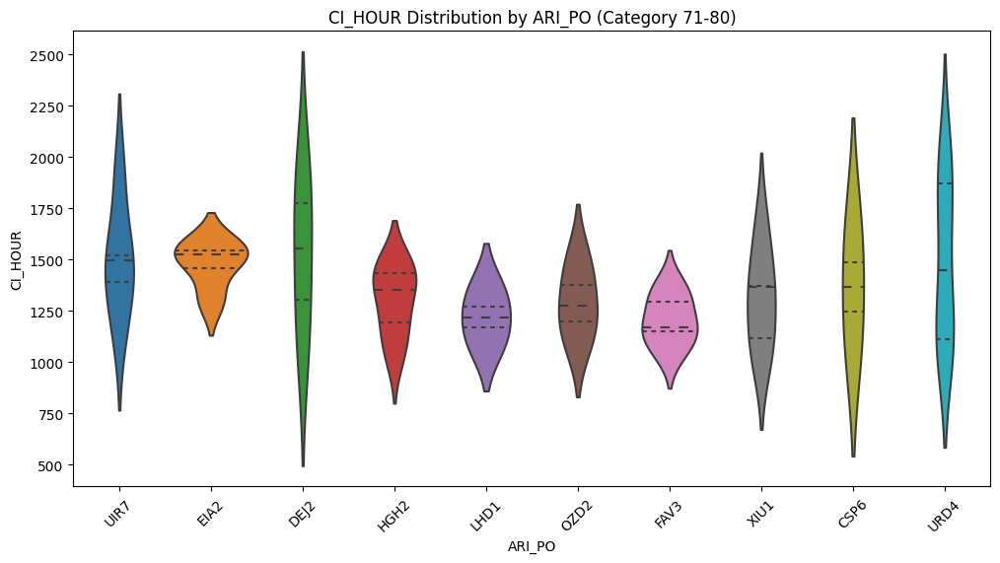

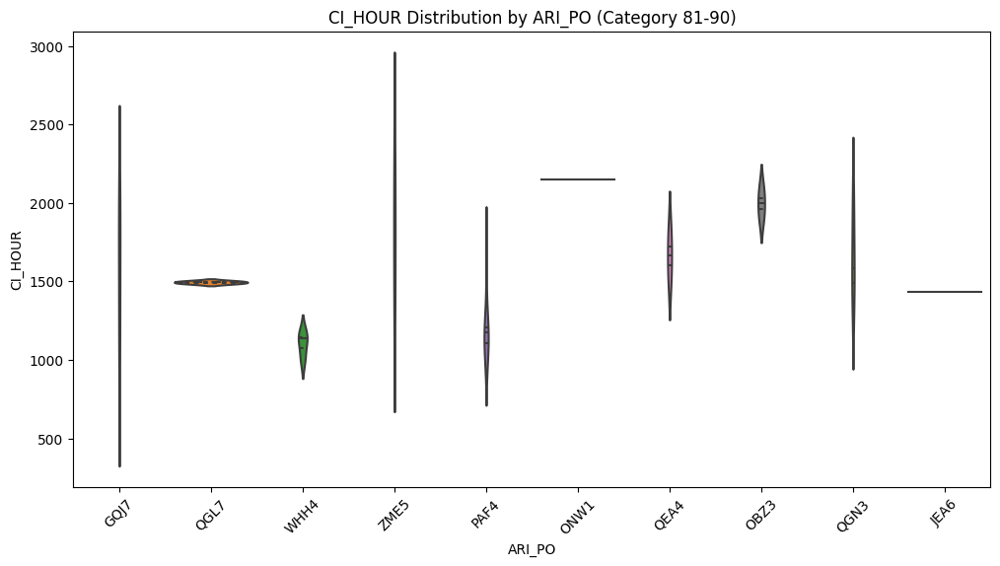

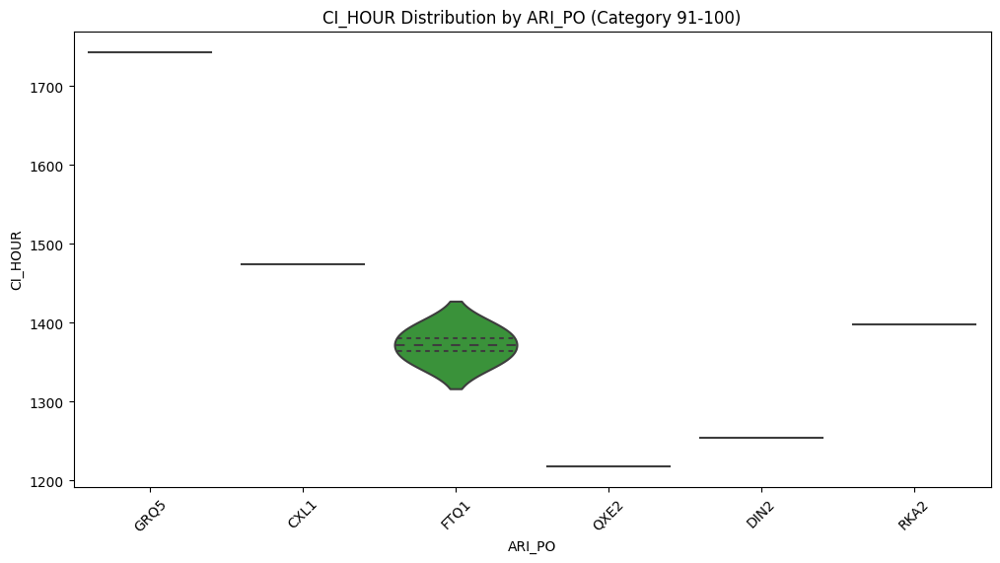

In [ ]:
target = 'ARI_PO'
# 10개씩 카테고리를 끊어서 박스 플롯 그리기
categories = train[target].unique()

for i in range(0, len(categories), 10):
    subset = train[train[target].isin(categories[i:i+10])]

    plt.figure(figsize=(12, 6))
    sns.boxplot(x=target, y='CI_HOUR', data=subset)

    plt.title(f'CI_HOUR Distribution by ARI_PO (Category {i+1}-{i+10})')
    plt.xlabel(target)
    plt.ylabel('CI_HOUR')
    plt.xticks(rotation=45)  # x축 라벨 회전 (옵션)
    plt.show()

# 10개씩 카테고리를 끊어서 바이올린 플롯 그리기
for i in range(0, len(categories), 10):
    subset = train[train[target].isin(categories[i:i+10])]

    plt.figure(figsize=(12, 6))
    sns.violinplot(x=target, y='CI_HOUR', data=subset, inner='quartile')

    plt.title(f'CI_HOUR Distribution by ARI_PO (Category {i+1}-{i+10})')
    plt.xlabel(target)
    plt.ylabel('CI_HOUR')
    plt.xticks(rotation=45)  # x축 라벨 회전 (옵션)
    plt.show()

ARI_PO
AIB7    1224.092963
AZU6    1427.116131
BAZ5    1118.935278
BGD2    1486.135159
BGX4    1561.128009
           ...     
YDP4    1121.085000
YFK5    1804.749583
YRT6    1399.983249
ZAG4    1393.481960
ZME5    1815.357222
Name: CI_HOUR, Length: 96, dtype: float64
ARI_PO
AIB7     3
AZU6    28
BAZ5     5
BGD2    21
BGX4    12
        ..
YDP4     1
YFK5     2
YRT6    33
ZAG4    53
ZME5     2
Name: CI_HOUR, Length: 96, dtype: int64


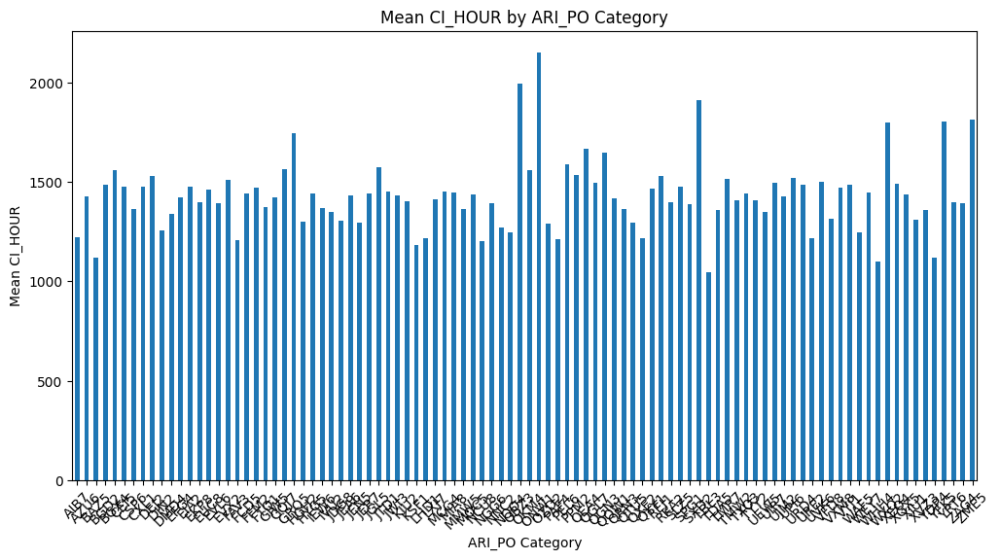

In [ ]:
# 카테고리별로 그룹화하여 CI_HOUR의 평균 계산
mean_ci_hour_per_category = train.groupby(target)['CI_HOUR'].mean()

# 결과 출력
print(mean_ci_hour_per_category)

# 카테고리별로 그룹화하여 데이터의 개수 계산
count_per_category = train.groupby(target)['CI_HOUR'].count()

# 결과 출력
print(count_per_category)

# 평균 CI_HOUR를 bar plot으로 시각화
plt.figure(figsize=(12, 6))
mean_ci_hour_per_category.plot(kind='bar')
plt.title('Mean CI_HOUR by ARI_PO Category')
plt.xlabel('ARI_PO Category')
plt.ylabel('Mean CI_HOUR')
plt.xticks(rotation=45)  # x축 라벨 회전 (옵션)
plt.show()

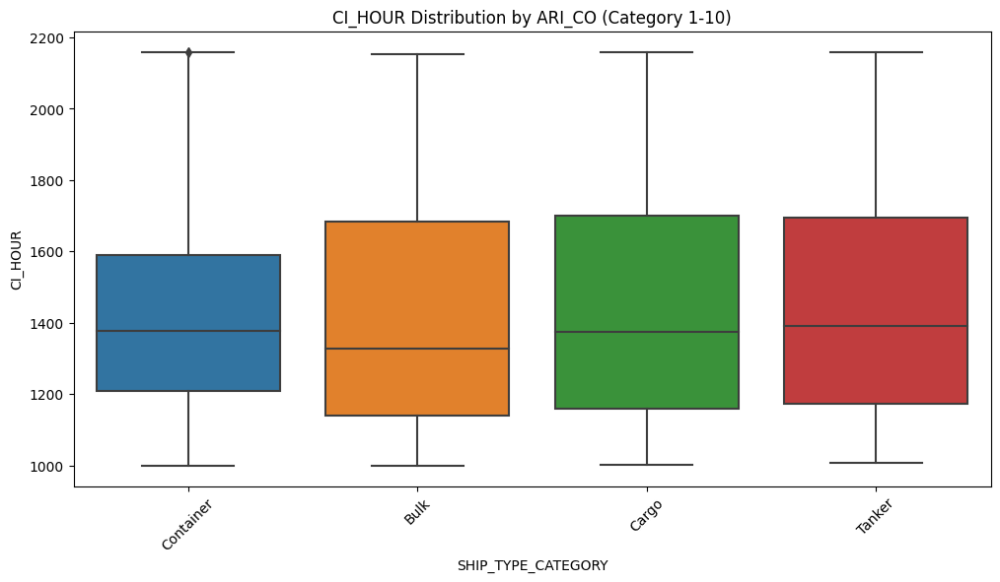

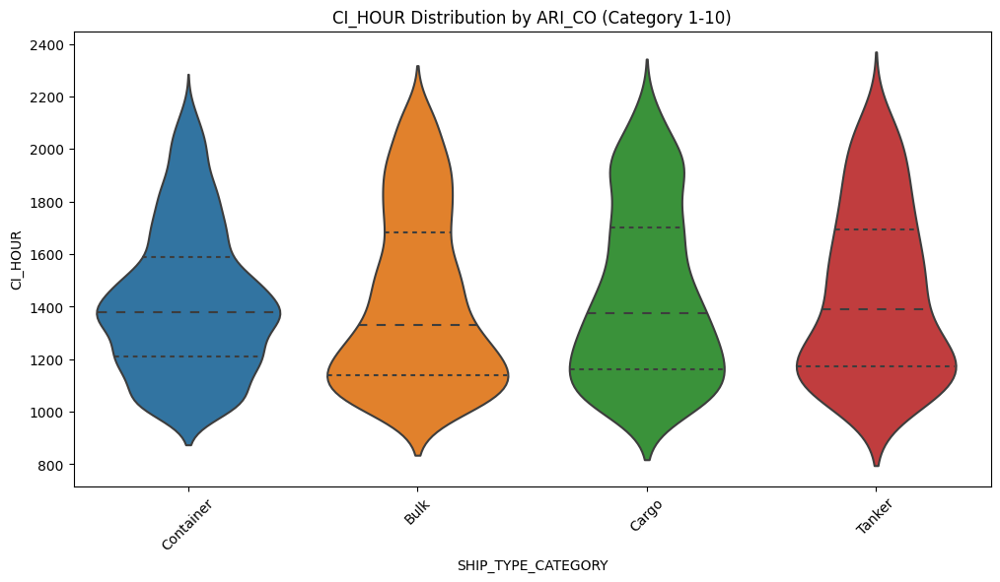

In [ ]:
target = 'SHIP_TYPE_CATEGORY'
# 10개씩 카테고리를 끊어서 박스 플롯 그리기
categories = train[target].unique()

for i in range(0, len(categories), 10):
    subset = train[train[target].isin(categories[i:i+10])]

    plt.figure(figsize=(12, 6))
    sns.boxplot(x=target, y='CI_HOUR', data=subset)

    plt.title(f'CI_HOUR Distribution by ARI_CO (Category {i+1}-{i+10})')
    plt.xlabel(target)
    plt.ylabel('CI_HOUR')
    plt.xticks(rotation=45)  # x축 라벨 회전 (옵션)
    plt.show()

# 10개씩 카테고리를 끊어서 바이올린 플롯 그리기
for i in range(0, len(categories), 10):
    subset = train[train[target].isin(categories[i:i+10])]

    plt.figure(figsize=(12, 6))
    sns.violinplot(x=target, y='CI_HOUR', data=subset, inner='quartile')

    plt.title(f'CI_HOUR Distribution by ARI_CO (Category {i+1}-{i+10})')
    plt.xlabel(target)
    plt.ylabel('CI_HOUR')
    plt.xticks(rotation=45)  # x축 라벨 회전 (옵션)
    plt.show()

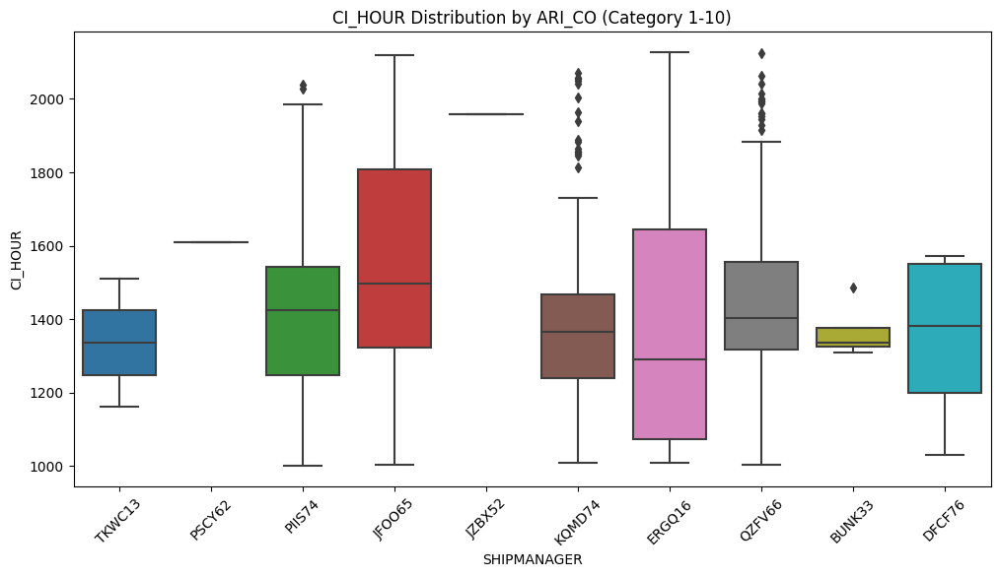

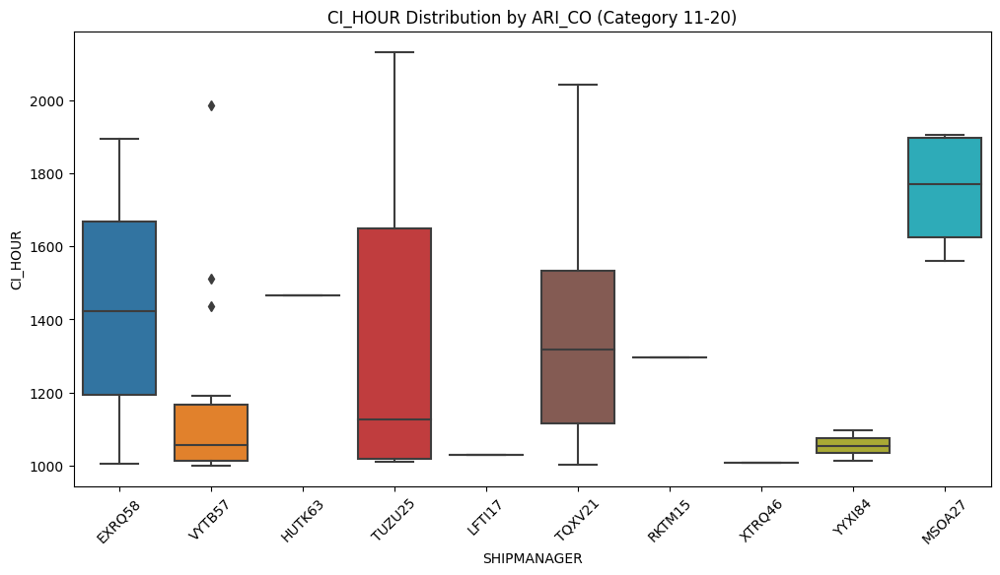

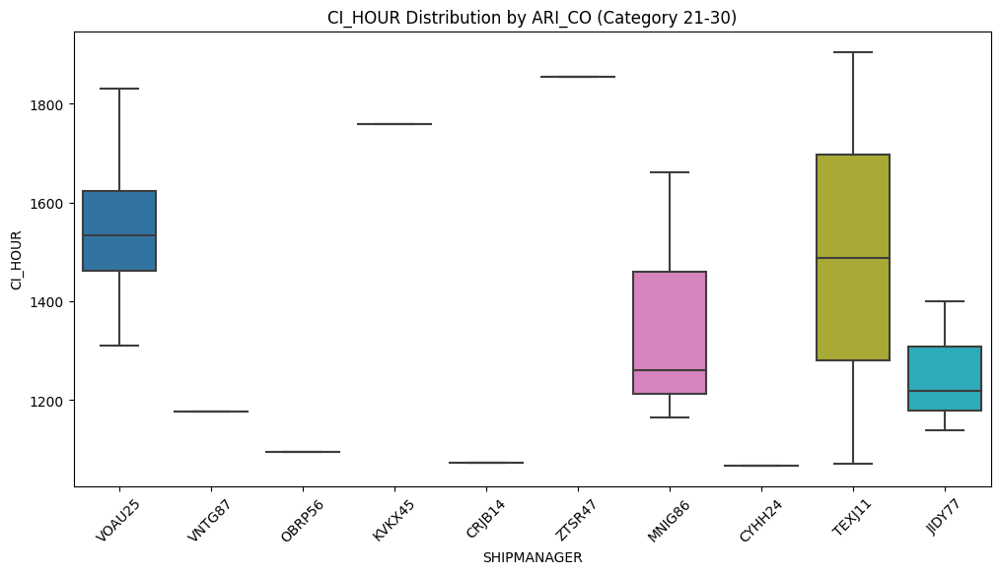

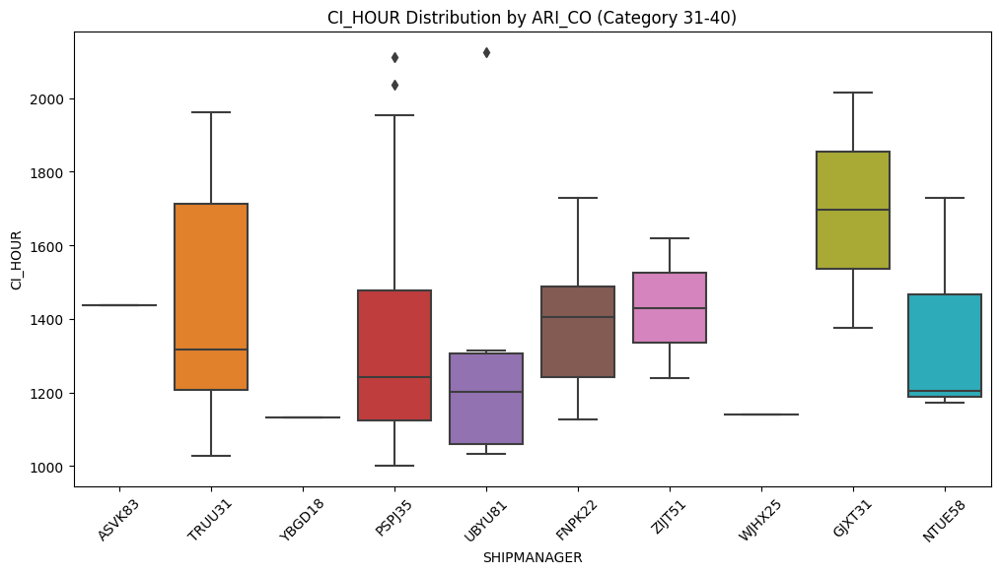

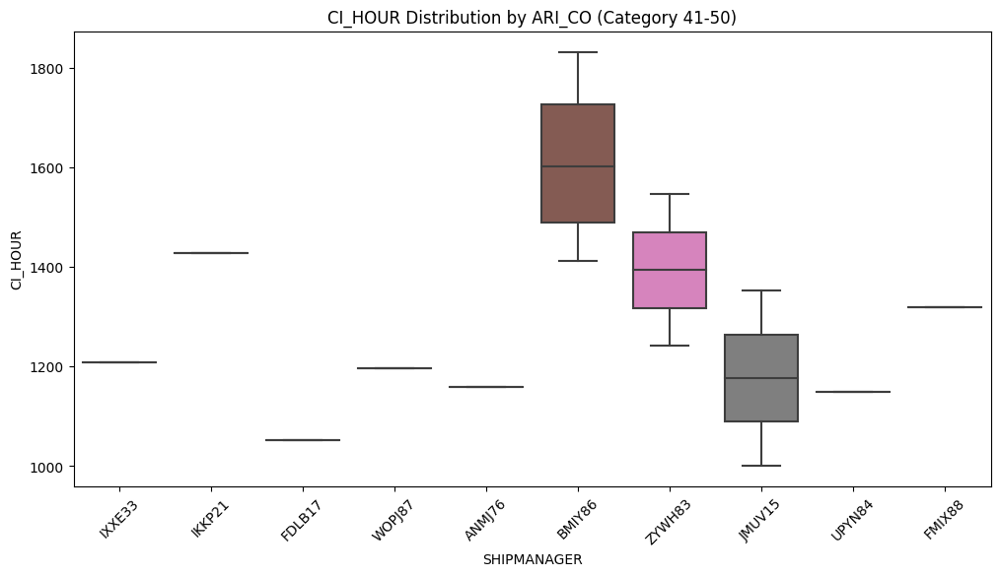

...

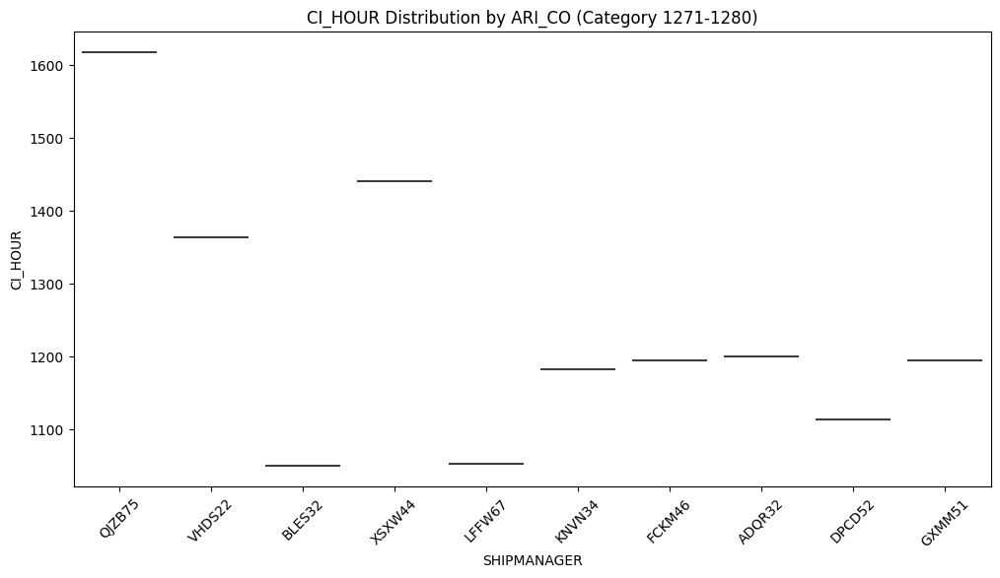

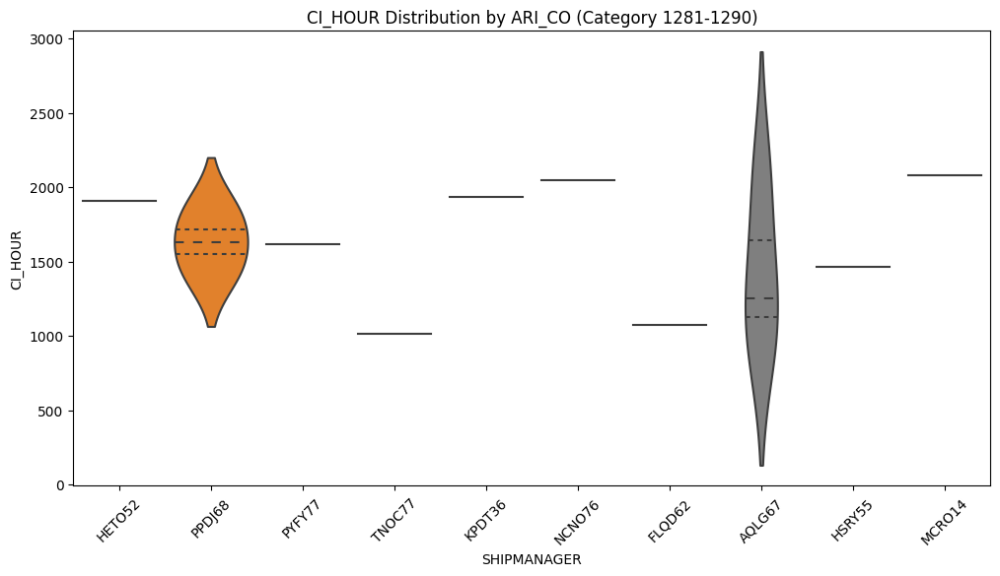

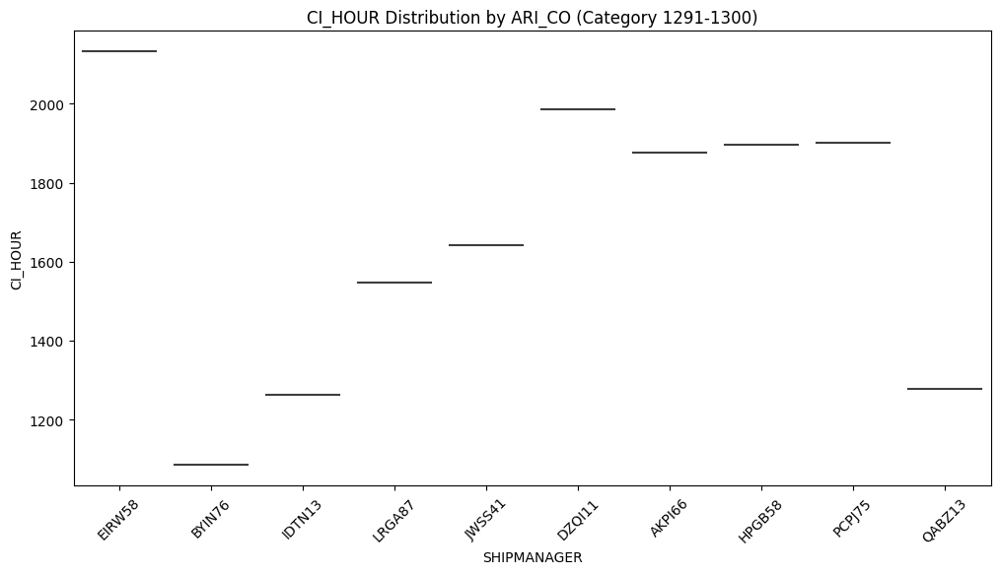

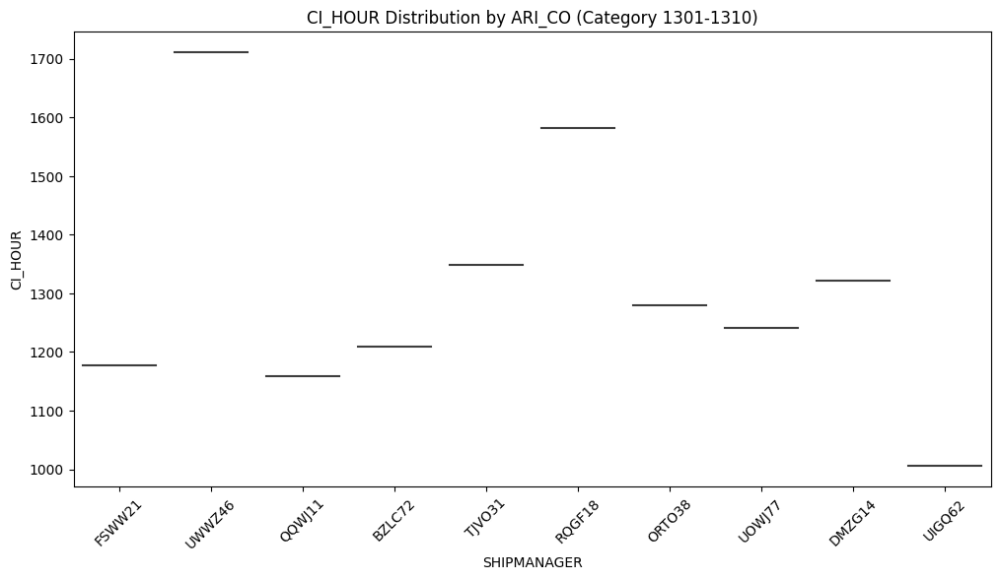

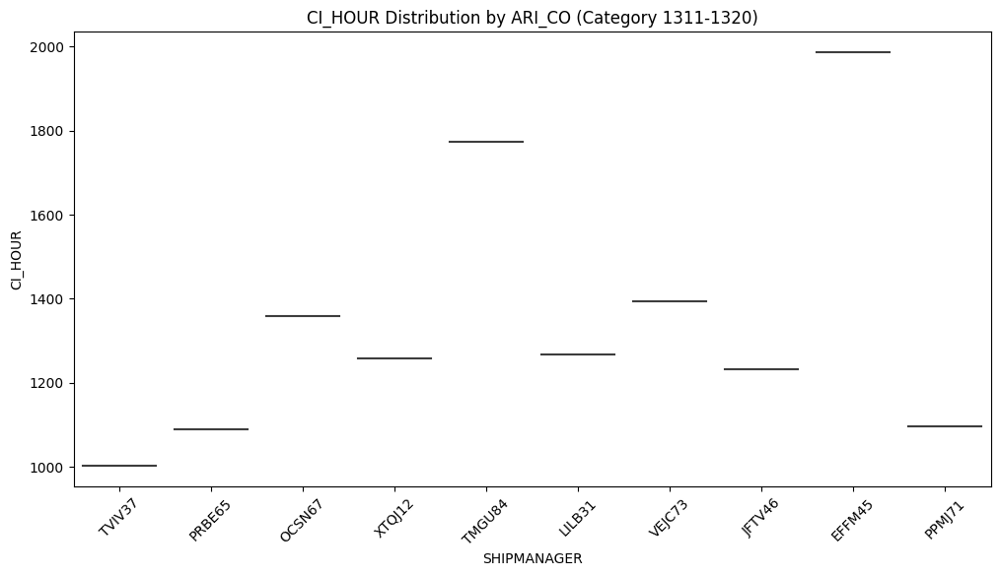

In [ ]:
target = 'SHIPMANAGER'
# 10개씩 카테고리를 끊어서 박스 플롯 그리기
categories = train[target].unique()

for i in range(0, len(categories), 10):
    subset = train[train[target].isin(categories[i:i+10])]

    plt.figure(figsize=(12, 6))
    sns.boxplot(x=target, y='CI_HOUR', data=subset)

    plt.title(f'CI_HOUR Distribution by ARI_CO (Category {i+1}-{i+10})')
    plt.xlabel(target)
    plt.ylabel('CI_HOUR')
    plt.xticks(rotation=45)  # x축 라벨 회전 (옵션)
    plt.show()

# 10개씩 카테고리를 끊어서 바이올린 플롯 그리기
for i in range(0, len(categories), 10):
    subset = train[train[target].isin(categories[i:i+10])]

    plt.figure(figsize=(12, 6))
    sns.violinplot(x=target, y='CI_HOUR', data=subset, inner='quartile')

    plt.title(f'CI_HOUR Distribution by ARI_CO (Category {i+1}-{i+10})')
    plt.xlabel(target)
    plt.ylabel('CI_HOUR')
    plt.xticks(rotation=45)  # x축 라벨 회전 (옵션)
    plt.show()

# ATA

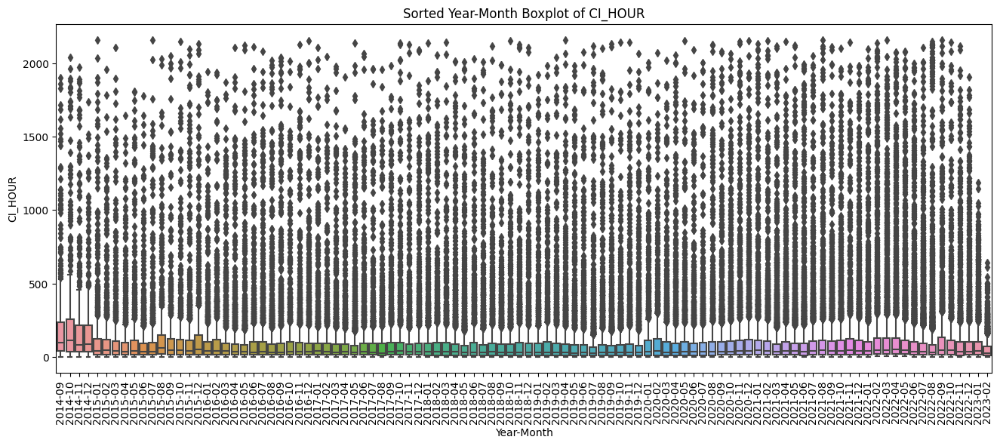

In [ ]:
data = train.copy()
# ATA를 datetime 형식으로 변환 (이미 datetime 형식이라면 이 과정은 생략해도 됩니다.)
data['ATA'] = pd.to_datetime(data['ATA'])

# 연-월 정보를 추가
data['Year-Month'] = data['ATA'].dt.to_period('M')

# 연-월 정보로 데이터를 정렬
data = data.sort_values(by='Year-Month')

# 연-월별 박스플롯 그리기
plt.figure(figsize=(16, 6))
sns.boxplot(x='Year-Month', y='CI_HOUR', data=data)
plt.xticks(rotation=90)  # x축 라벨을 회전하여 겹치지 않게 함
plt.title('Sorted Year-Month Boxplot of CI_HOUR')
plt.show()

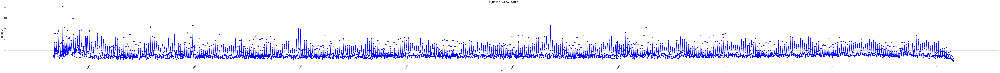

In [ ]:
# 재시도: 가상의 데이터와 그래프 생성

import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# datetime 컬럼 처리
train['ATA'] = pd.to_datetime(train['ATA'])
test['ATA'] = pd.to_datetime(test['ATA'])

train['Date'] = train['ATA'].dt.date

# 날짜별 CI_HOUR 평균 계산
average_ci_hour_per_day = train.groupby('Date')['CI_HOUR'].mean().reset_index()

# 결과 출력
average_ci_hour_per_day

# ATA를 x축으로, CI_HOUR을 y축으로 하는 플롯 생성
plt.figure(figsize=(80,6))
plt.plot(average_ci_hour_per_day['Date'], average_ci_hour_per_day['CI_HOUR'], marker='o', linestyle='-', color='b')
plt.title('CI_HOUR Trend Over DATEE')
plt.xlabel('DATE')
plt.ylabel('CI_HOUR')
plt.grid(True)
plt.xticks(rotation=45)  # x축 레이블을 45도 회전하여 보기 쉽게 만듭니다.
plt.tight_layout()  # 레이블이 그래프와 겹치지 않도록 레이아웃을 자동 조정합니다.
plt.show()


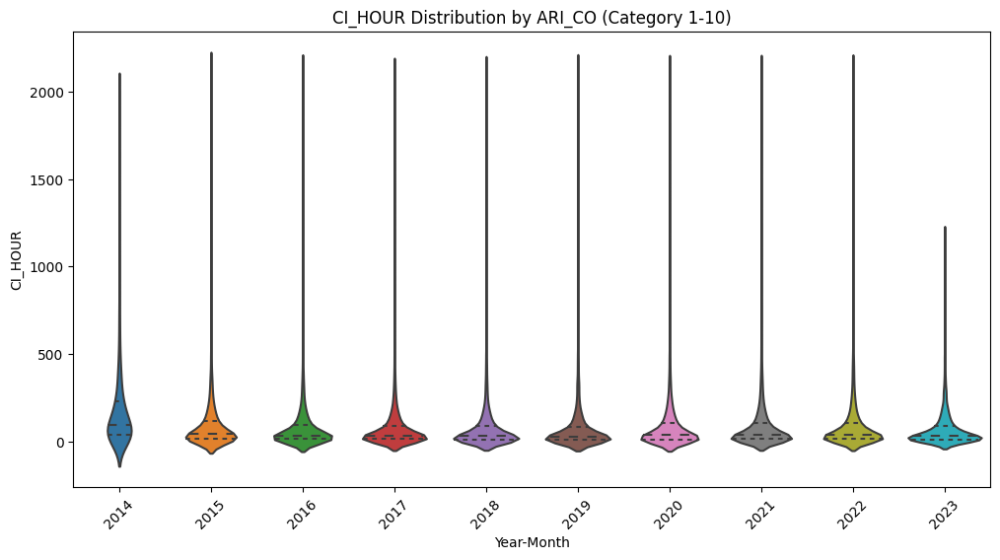

In [ ]:
data = train[train['DIST'] != 0].copy()
#data = train[train['DIST'] == 0].copy()

# ATA를 datetime 형식으로 변환 (이미 datetime 형식이라면 이 과정은 생략해도 됩니다.)
data['ATA'] = pd.to_datetime(data['ATA'])

# 연-월 정보를 추가
data['Year-Month'] = data['ATA'].dt.to_period('Y')

# 연-월 정보로 데이터를 정렬
data = data.sort_values(by='Year-Month')

target = 'Year-Month'
categories = data[target].unique()

# 10개씩 카테고리를 끊어서 바이올린 플롯 그리기
for i in range(0, len(categories), 10):
    subset = data[data[target].isin(categories[i:i+10])]

    plt.figure(figsize=(12, 6))
    sns.violinplot(x=target, y='CI_HOUR', data=subset, inner='quartile')

    plt.title(f'CI_HOUR Distribution by ARI_CO (Category {i+1}-{i+10})')
    plt.xlabel(target)
    plt.ylabel('CI_HOUR')
    plt.xticks(rotation=45)  # x축 라벨 회전 (옵션)
    plt.show()

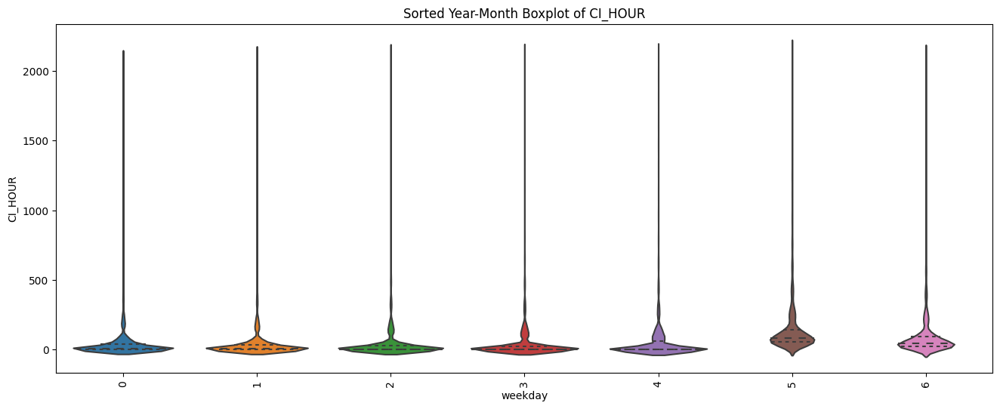

In [ ]:
data = train.copy()
#data = train[train['DIST'] == 0].copy()

# 연-월별 박스플롯 그리기
plt.figure(figsize=(16, 6))
#sns.boxplot(x='month', y='CI_HOUR', data=data)
sns.violinplot(x='weekday', y='CI_HOUR', data=data, inner='quartile')
plt.xticks(rotation=90)  # x축 라벨을 회전하여 겹치지 않게 함
plt.title('Sorted Year-Month Boxplot of CI_HOUR')
plt.show()

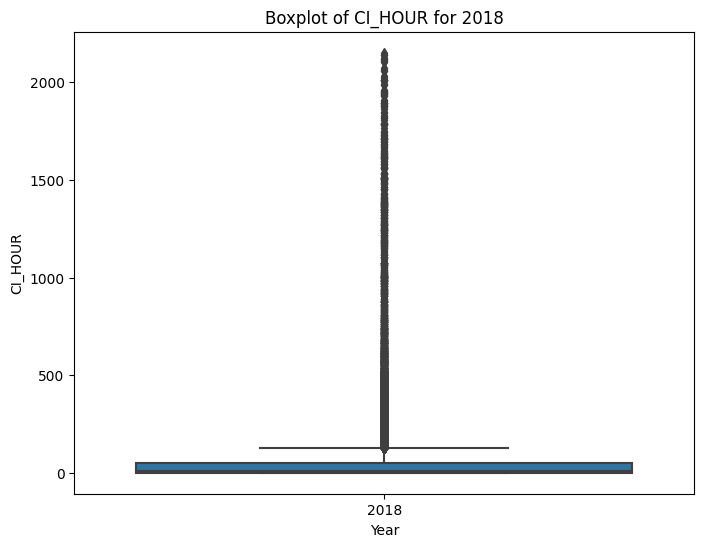

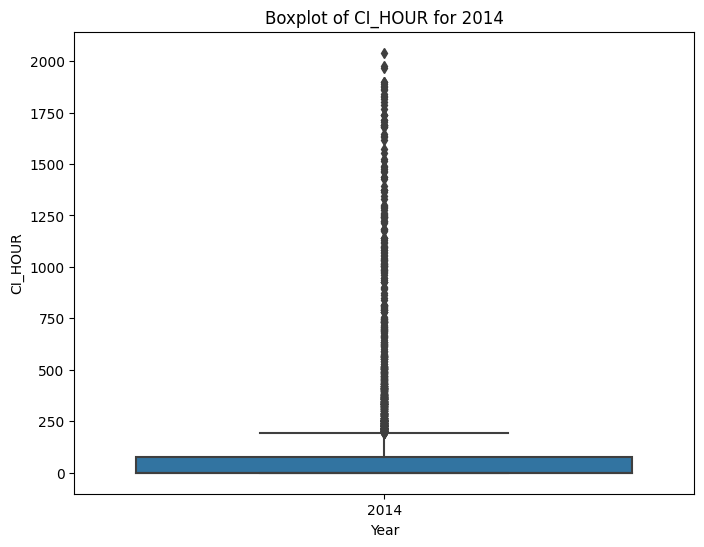

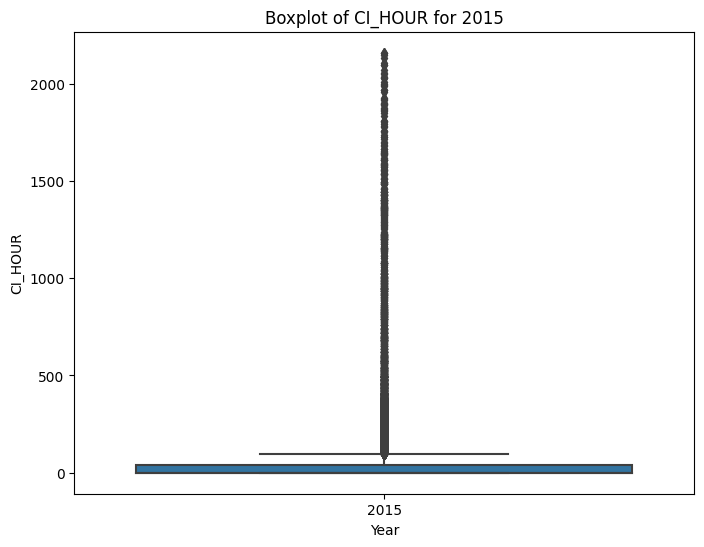

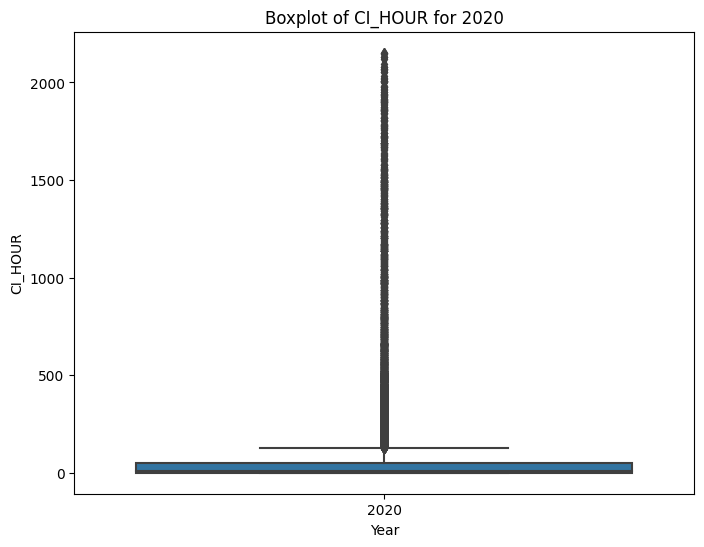

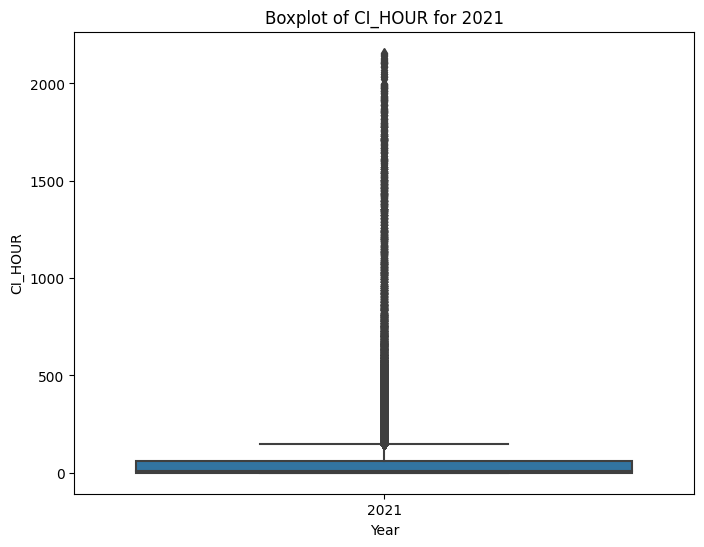

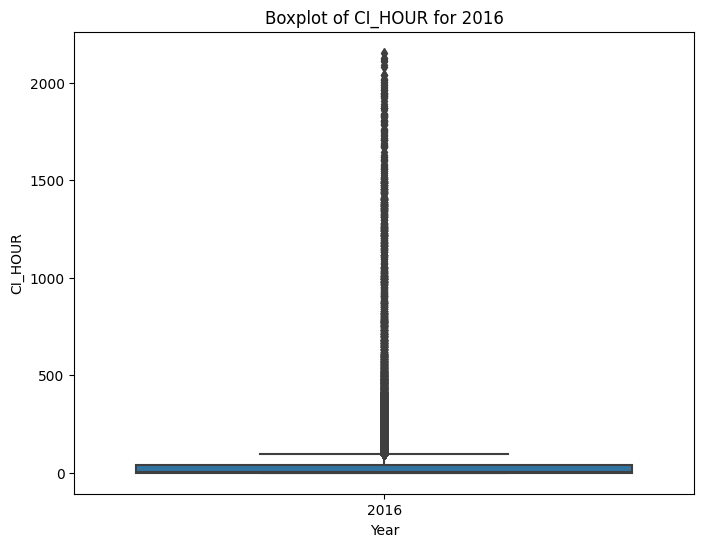

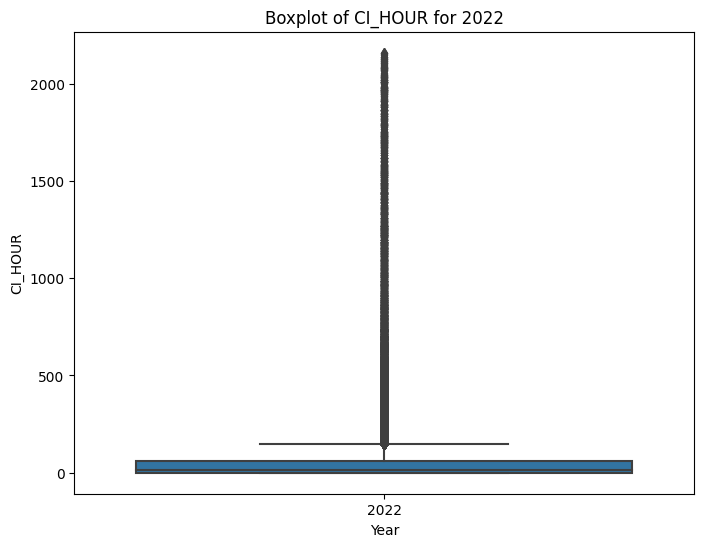

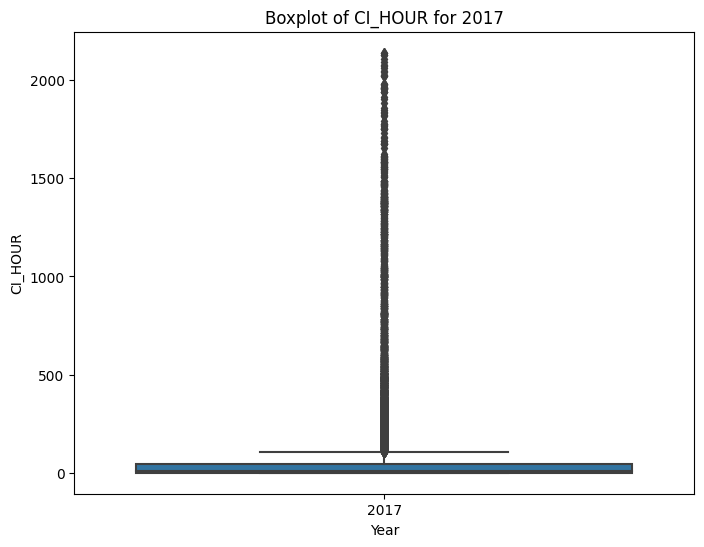

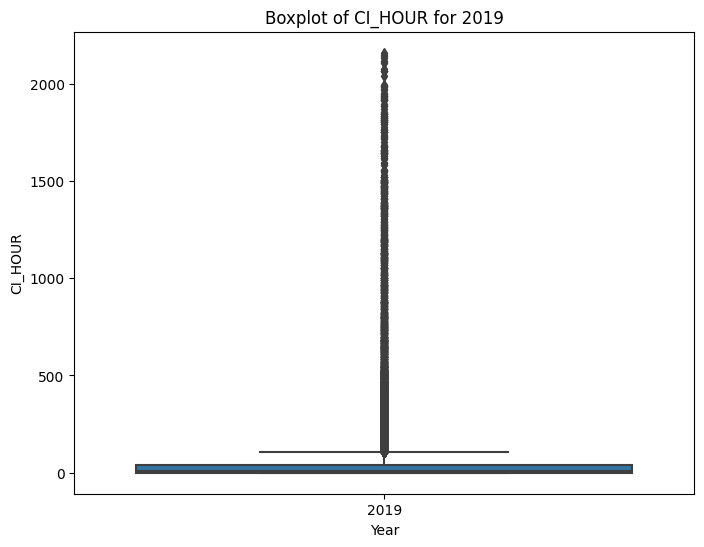

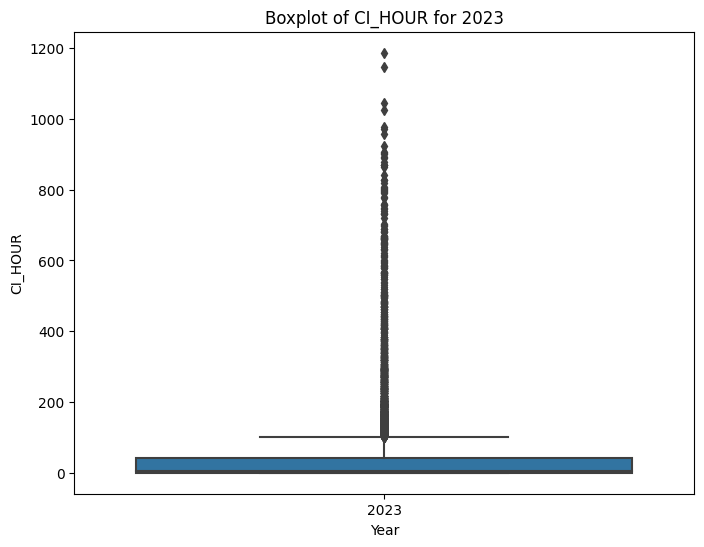

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# 가정: train 변수에 데이터가 이미 로드되어 있음
data = train.copy()

# ATA를 datetime 형식으로 변환
data['ATA'] = pd.to_datetime(data['ATA'])

# 연 정보를 추가
data['Year'] = data['ATA'].dt.year

# 년도별로 데이터를 필터링하여 박스플롯 그리기
years = data['Year'].unique()

for year in years:
    yearly_data = data[data['Year'] == year]

    plt.figure(figsize=(8, 6))
    sns.boxplot(x='Year', y='CI_HOUR', data=yearly_data)
    plt.title(f'Boxplot of CI_HOUR for {year}')
    plt.show()


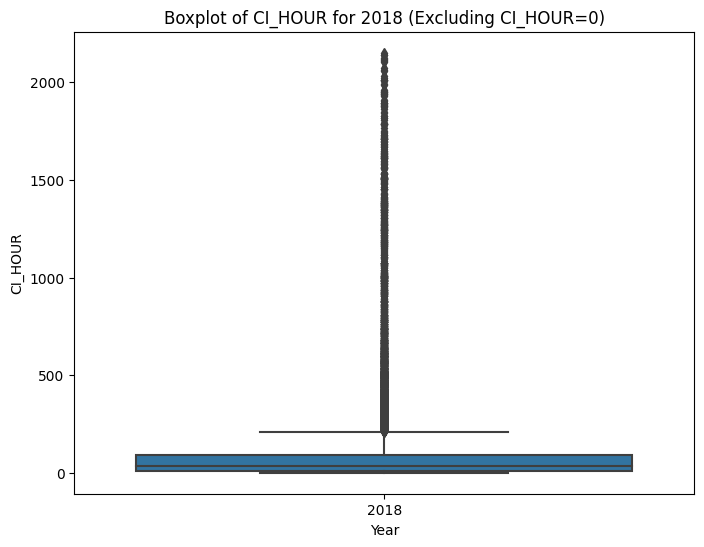

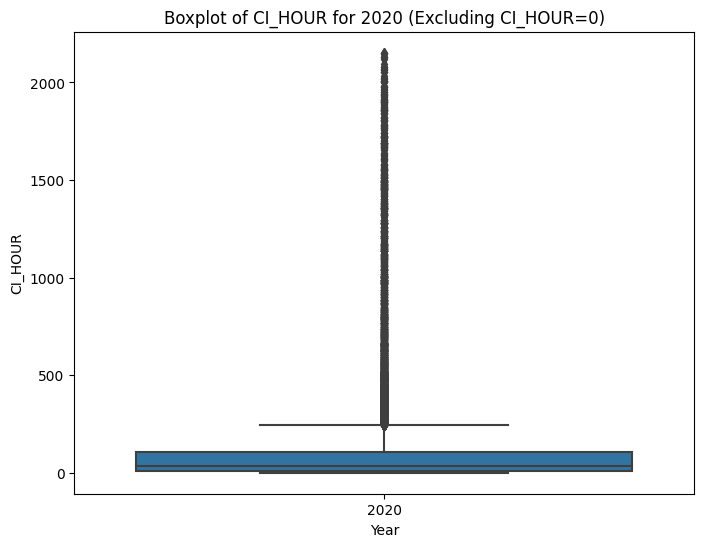

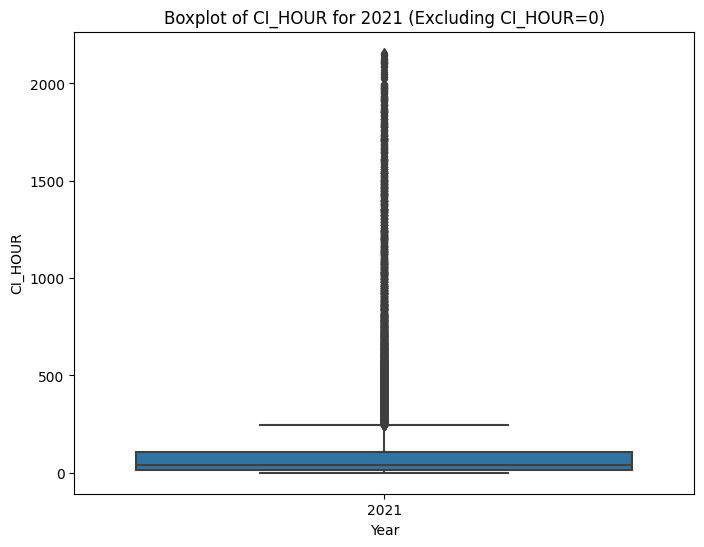

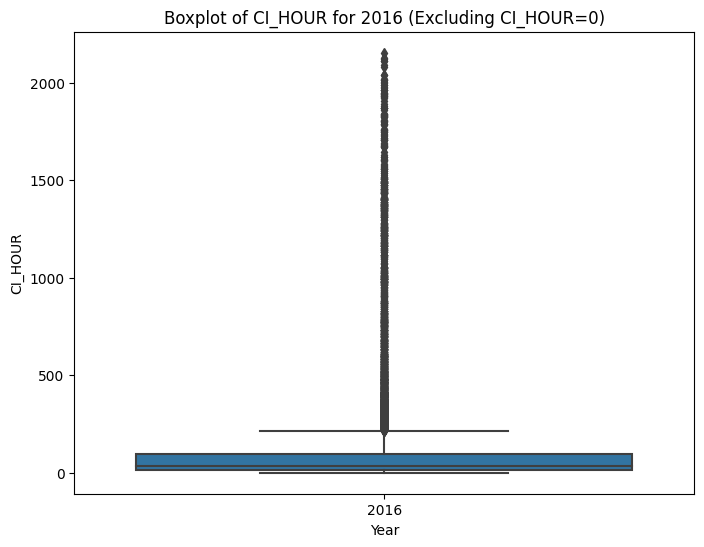

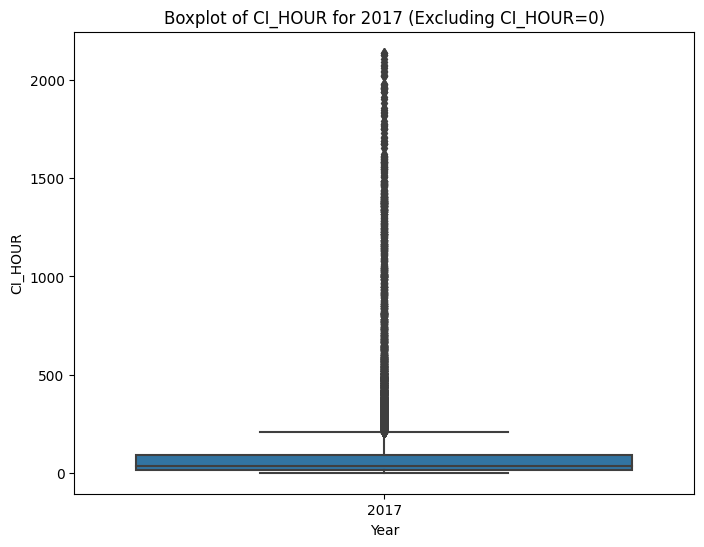

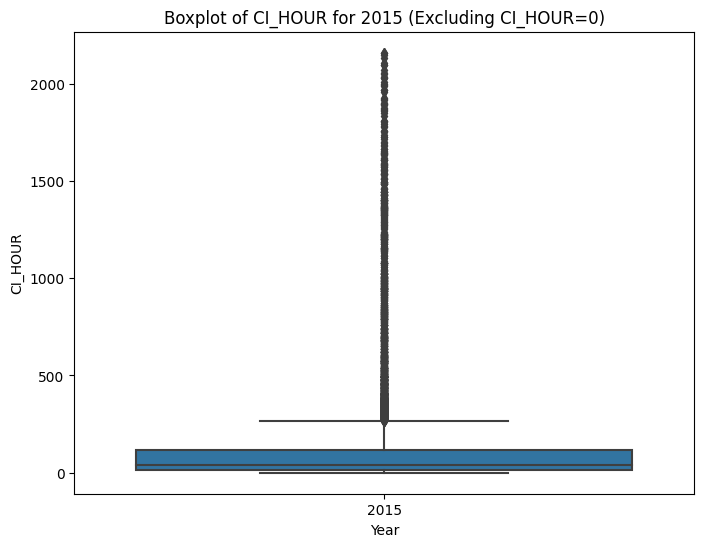

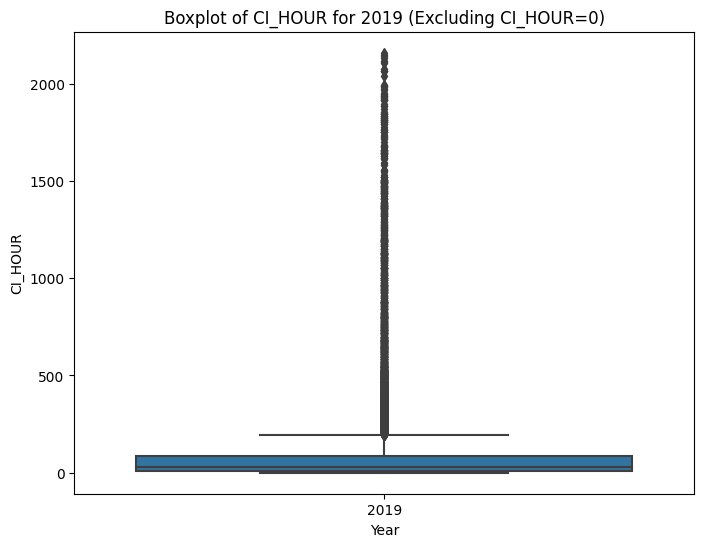

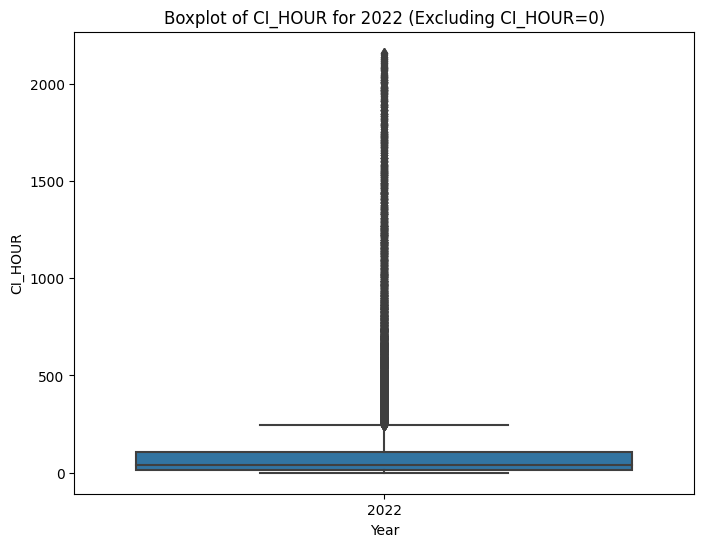

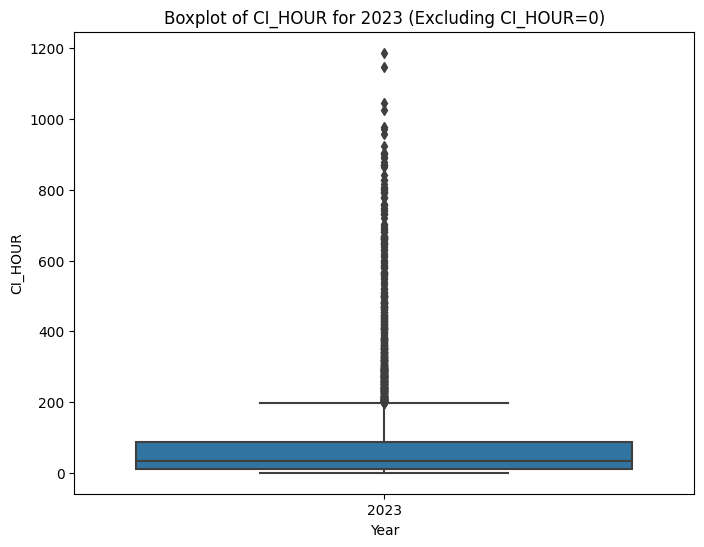

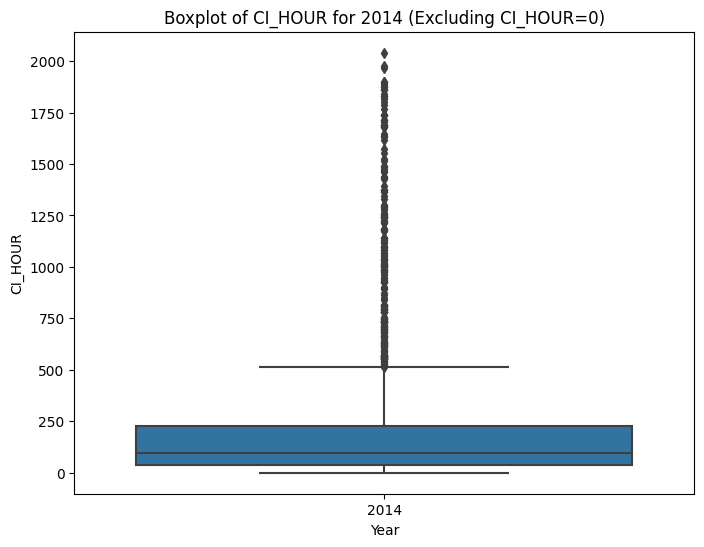

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# 가정: train 변수에 데이터가 이미 로드되어 있음
data = train.copy()

# ATA를 datetime 형식으로 변환
data['ATA'] = pd.to_datetime(data['ATA'])

# 연 정보를 추가
data['Year'] = data['ATA'].dt.year

# CI_HOUR가 0이 아닌 데이터만 필터링
data = data[data['CI_HOUR'] != 0]

# 년도별로 데이터를 필터링하여 박스플롯 그리기
years = data['Year'].unique()

for year in years:
    yearly_data = data[data['Year'] == year]

    plt.figure(figsize=(8, 6))
    sns.boxplot(x='Year', y='CI_HOUR', data=yearly_data)
    plt.title(f'Boxplot of CI_HOUR for {year} (Excluding CI_HOUR=0)')
    plt.show()


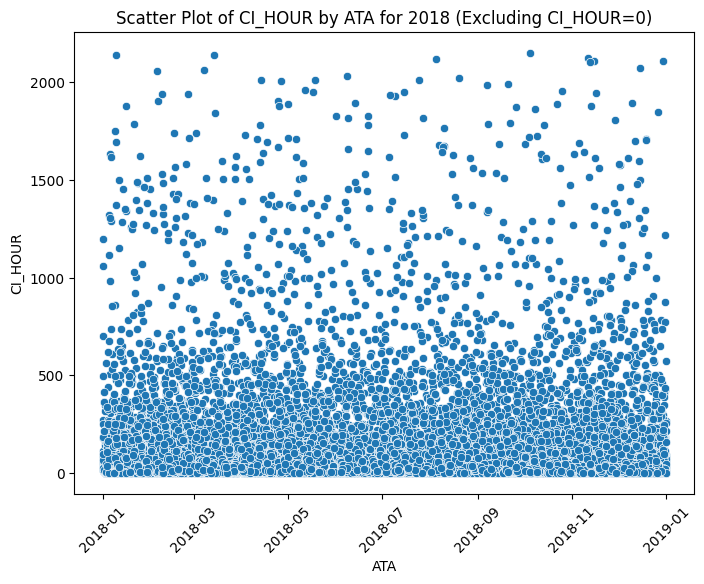

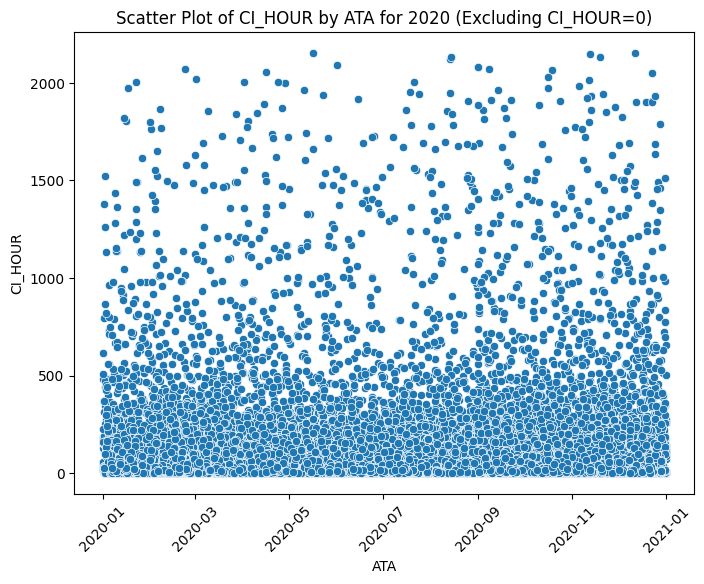

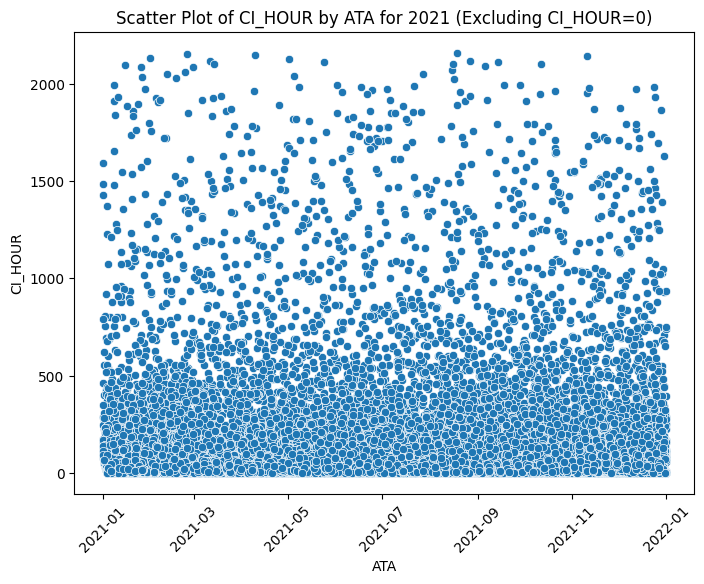

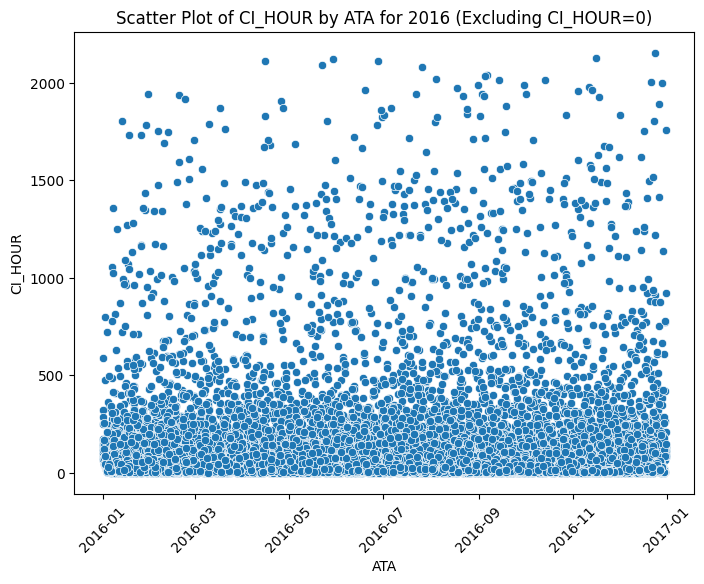

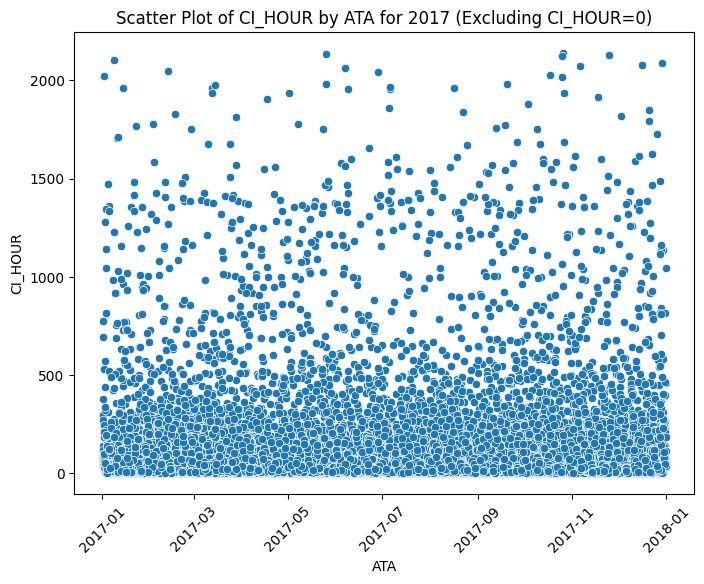

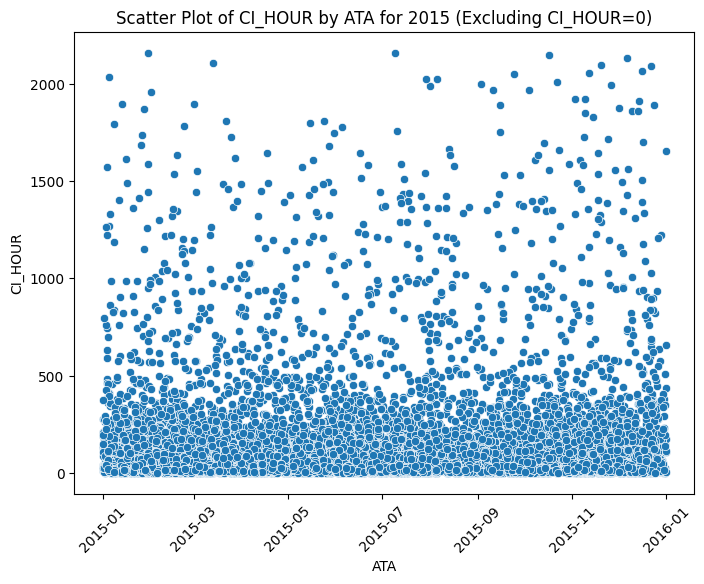

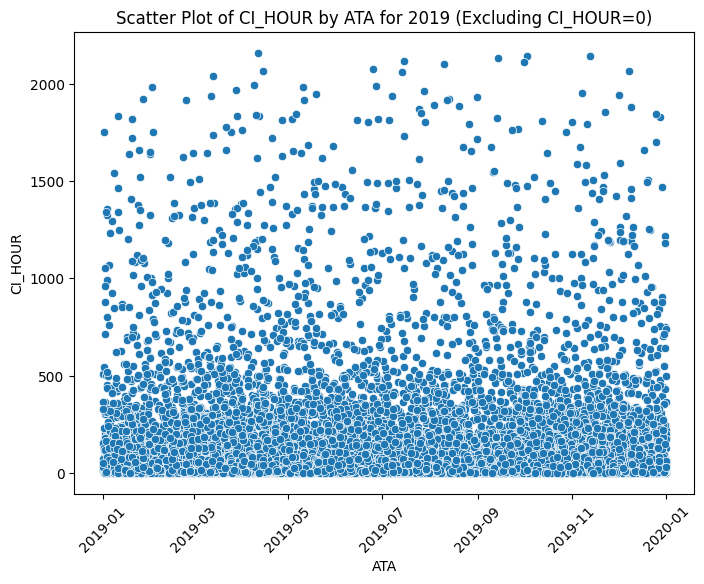

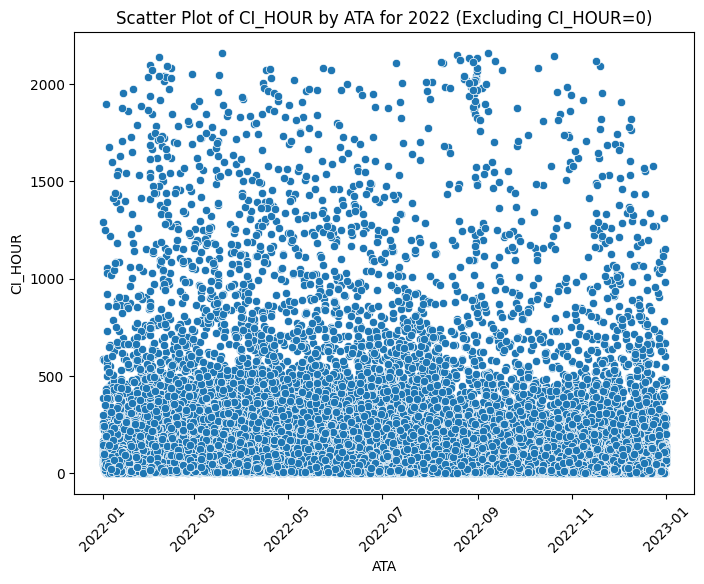

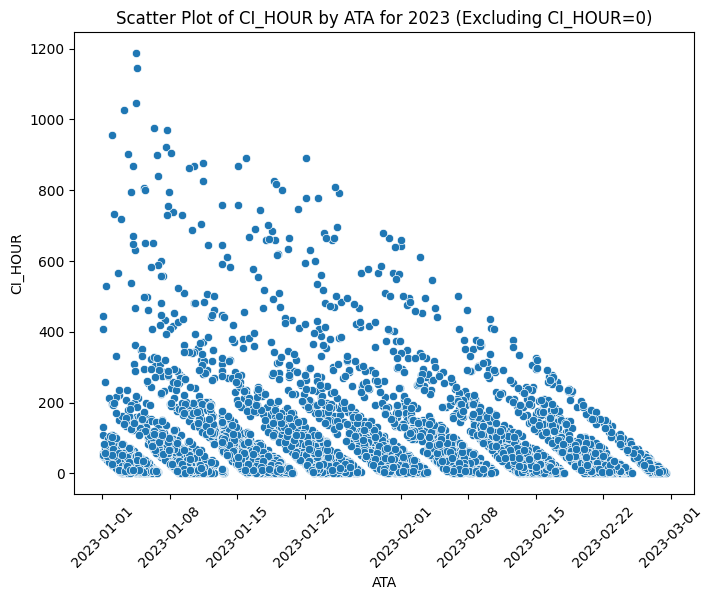

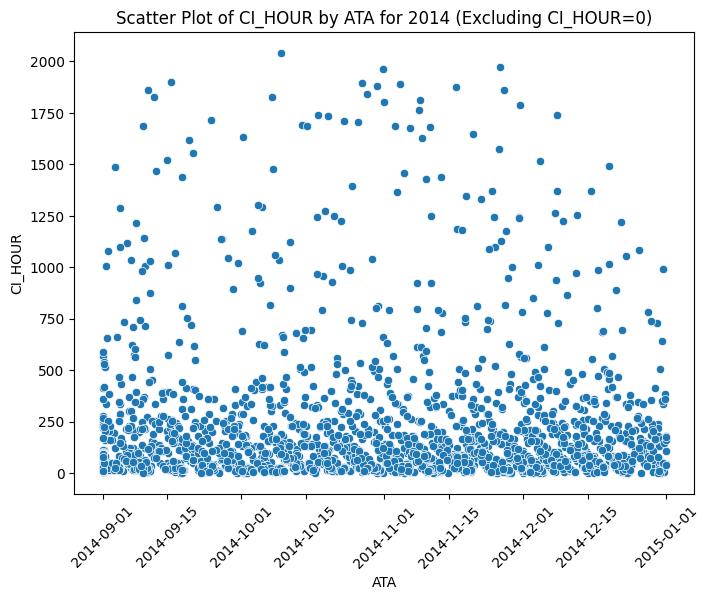

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# 가정: train 변수에 데이터가 이미 로드되어 있음
data = train.copy()

# ATA를 datetime 형식으로 변환
data['ATA'] = pd.to_datetime(data['ATA'])

# 연 정보를 추가
data['Year'] = data['ATA'].dt.year

# CI_HOUR가 0이 아닌 데이터만 필터링
data = data[data['CI_HOUR'] != 0]

# 년도별로 데이터를 필터링하여 스캐터 플롯 그리기
years = data['Year'].unique()

for year in years:
    yearly_data = data[data['Year'] == year]

    plt.figure(figsize=(8, 6))
    sns.scatterplot(data=yearly_data, x='ATA', y='CI_HOUR')
    plt.title(f'Scatter Plot of CI_HOUR by ATA for {year} (Excluding CI_HOUR=0)')
    plt.xticks(rotation=45)
    plt.show()


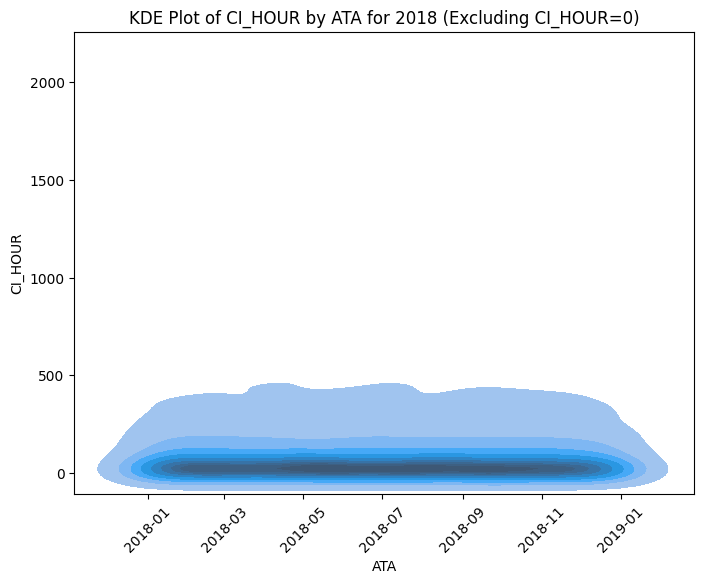

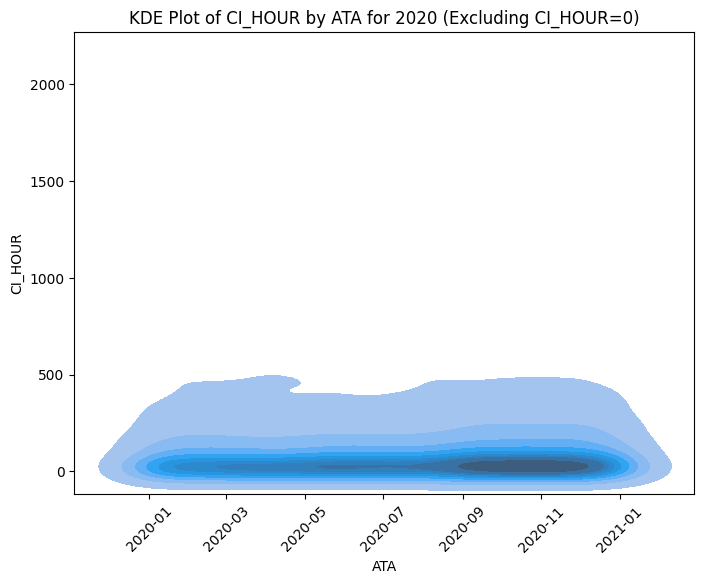

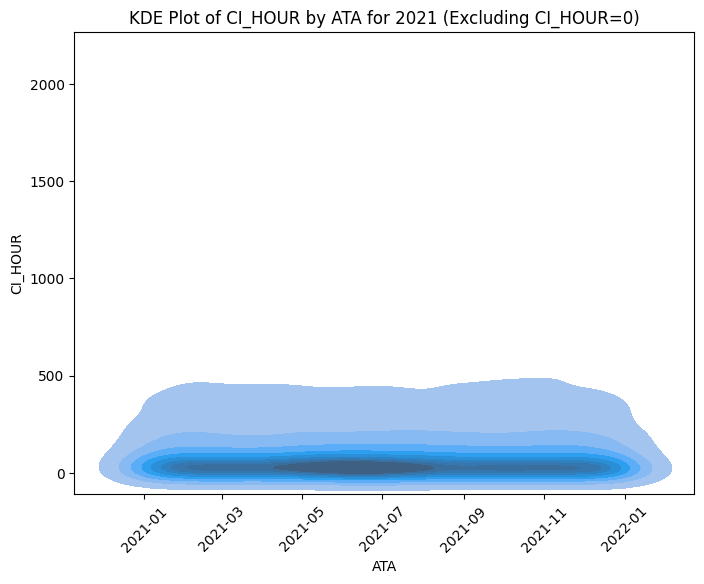

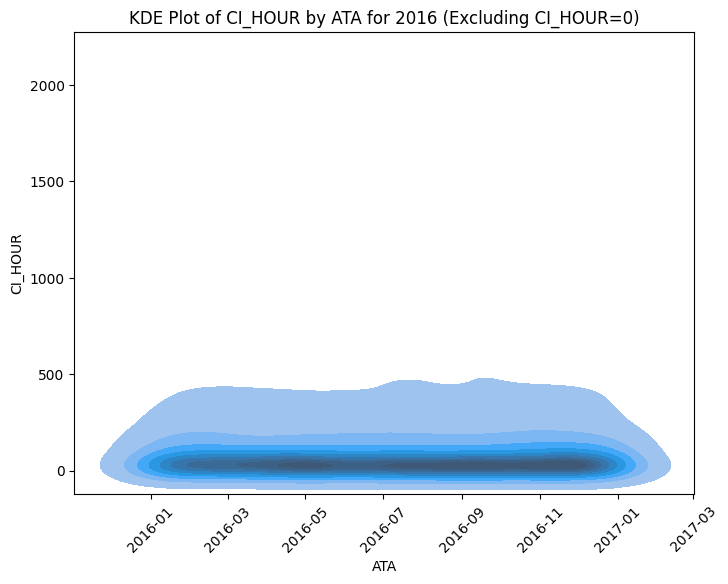

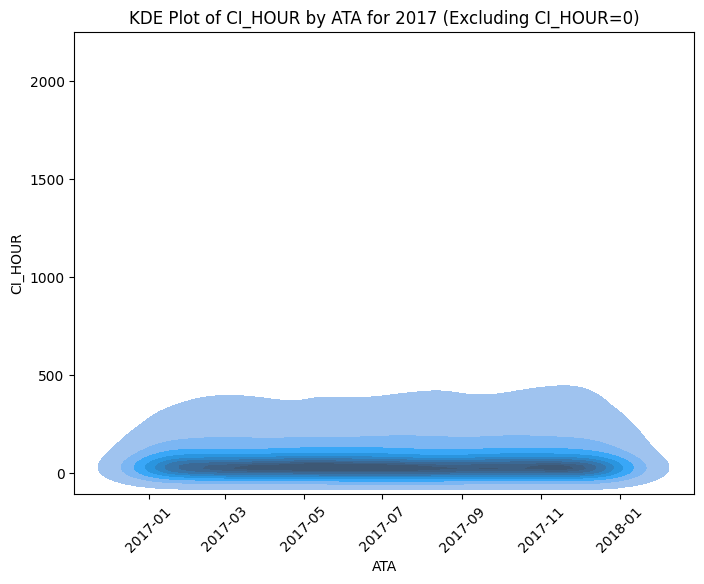

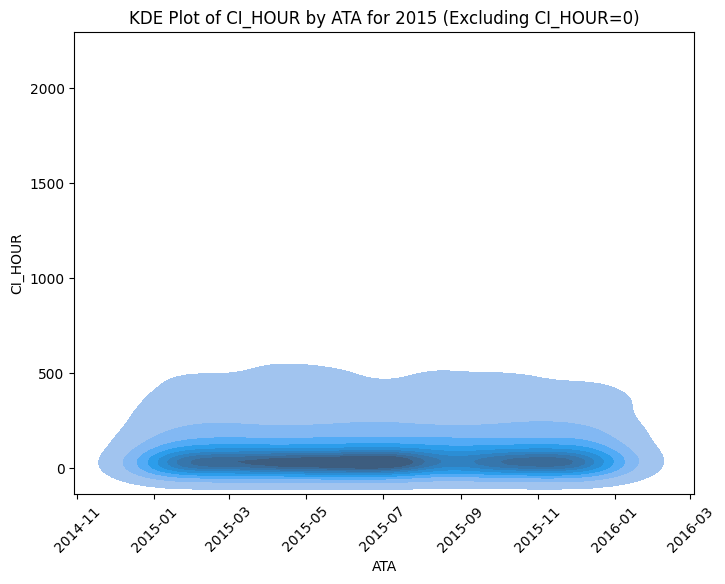

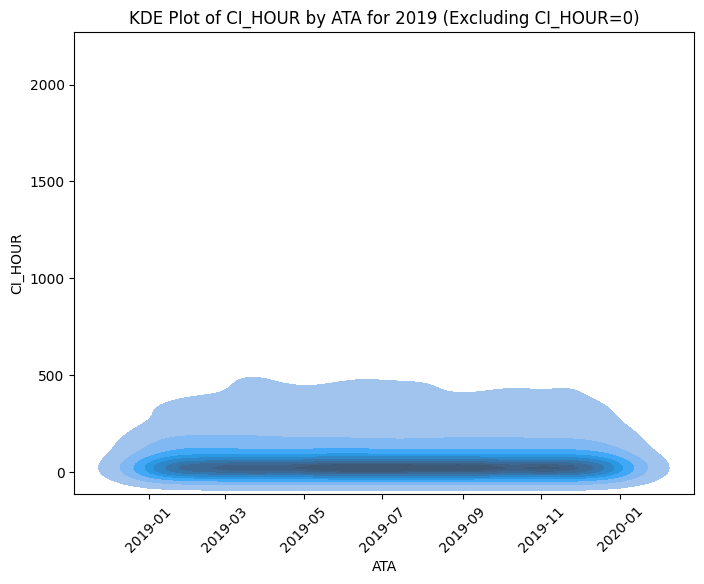

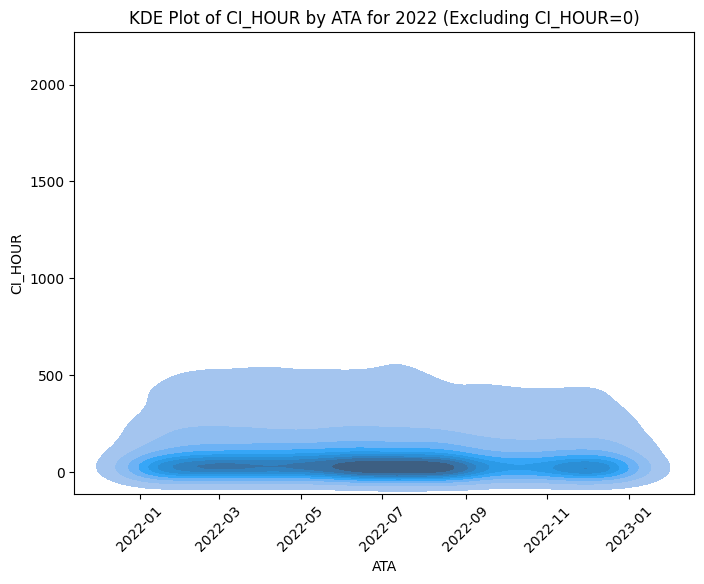

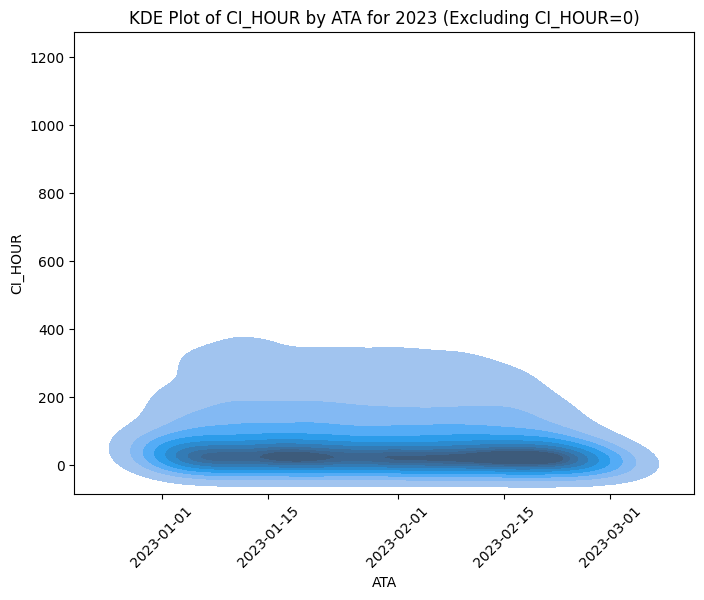

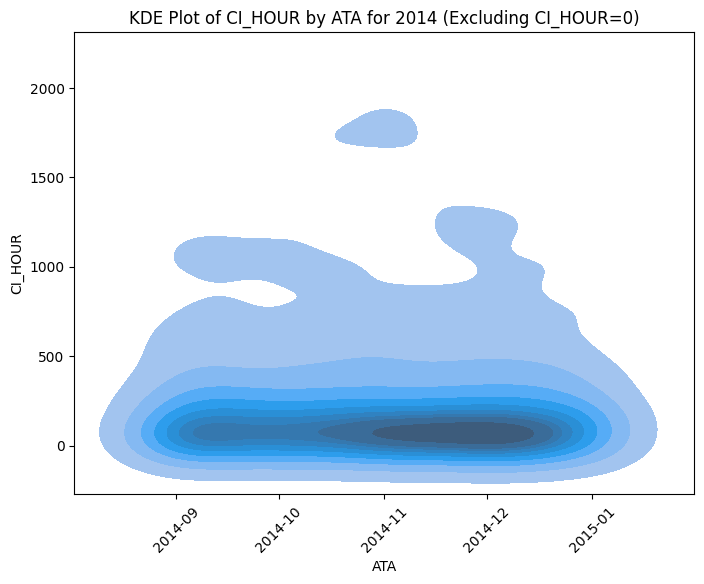

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# 가정: train 변수에 데이터가 이미 로드되어 있음
data = train.copy()

# ATA를 datetime 형식으로 변환
data['ATA'] = pd.to_datetime(data['ATA'])

# 연 정보를 추가
data['Year'] = data['ATA'].dt.year

# CI_HOUR가 0이 아닌 데이터만 필터링
data = data[data['CI_HOUR'] != 0]

# 년도별로 데이터를 필터링하여 KDE 플롯 그리기
years = data['Year'].unique()

for year in years:
    yearly_data = data[data['Year'] == year]

    plt.figure(figsize=(8, 6))
    sns.kdeplot(data=yearly_data, x='ATA', y='CI_HOUR', fill=True)
    plt.title(f'KDE Plot of CI_HOUR by ATA for {year} (Excluding CI_HOUR=0)')
    plt.xticks(rotation=45)
    plt.show()
